In [1]:
# importing necessary libaries 

import h5py
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
from sklearn.preprocessing import StandardScaler
import torch.nn.utils.prune as prune
from collections import OrderedDict
import copy
import time

In [2]:
# collecting the dataset file path
file_path = r'C:\Users\D\Documents\ni_range_dataset.h5'

In [3]:
# reading the hdf file 
with h5py.File(file_path, 'r') as f:
    print("File structure:")
    for key in f.keys():
        print(f"- {key}: {f[key].shape if hasattr(f[key], 'shape') else 'Group'}")

File structure:
- amplitude: (500, 64, 64, 64)
- defect_type: (500,)
- intensity: (500, 64, 64, 64)
- num_facets: (500,)
- phase: (500, 64, 64, 64)
- shape_type: (500,)
- size: (500,)
- xyz_file: (500,)


In [4]:
# loading the dataset at once

with h5py.File(file_path, 'r') as f:
    amplitude = f['amplitude'][:]
    intensity = f['intensity'][:]
    phase = f['phase'][:]
    defect_type = f['defect_type'][:]
    shape_type = f['shape_type'][:]
    size = f['size'][:]
    num_facets = f['num_facets'][:]
    xyz_file = f['xyz_file'][:]
print("Data loaded successfully!")

Data loaded successfully!


In [5]:
# viewing an instance of the amplitude slice
    
instance_0 = amplitude[0]  # Shape: (64, 64, 64)
    
print(f"Instance 0 shape: {instance_0.shape}")
print(f"Min value: {instance_0.min()}")
print(f"Max value: {instance_0.max()}")
print(f"Mean value: {instance_0.mean()}")
    

Instance 0 shape: (64, 64, 64)
Min value: 1.3190701793064363e-05
Max value: 1617.5096435546875
Mean value: 4.542590141296387


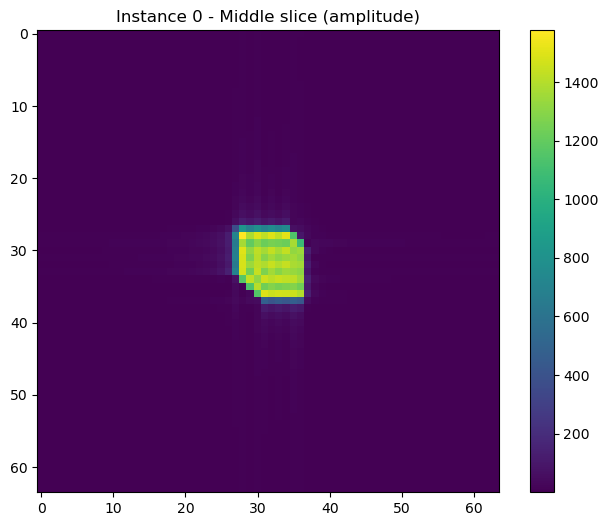

In [6]:
# View middle slice
plt.figure(figsize=(8, 6))
plt.imshow(instance_0[32], cmap='viridis')  # Middle slice
plt.title('Instance 0 - Middle slice (amplitude)')
plt.colorbar()
plt.show()

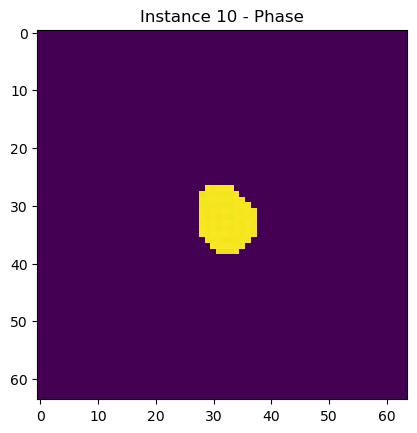

In [7]:
instance_10 = phase[10]
plt.imshow(instance_10[32], cmap='viridis')
plt.title('Instance 10 - Phase')
plt.show()

In [8]:
# function to view crystal sample

def view_crystal(instance_idx):
    """Quick function to view any crystal instance"""
    if instance_idx >= len(amplitude):
        print(f"Instance {instance_idx} doesn't exist. Max is {len(amplitude)-1}")
        return
    
    print(f"\nCrystal {instance_idx}:")
    print(f"- Defect type: {defect_type[instance_idx]}")
    print(f"- Shape type: {shape_type[instance_idx]}")
    print(f"- Size: {size[instance_idx]}")
    
    plt.figure(figsize=(15, 4))
    
    
    plt.subplot(1, 3, 1)
    plt.imshow(amplitude[instance_idx][32], cmap='viridis')
    plt.title('Amplitude')
    plt.colorbar()
    
    plt.subplot(1, 3, 2)
    plt.imshow(intensity[instance_idx][32], cmap='hot')
    plt.title('Intensity')
    plt.colorbar()
    
    plt.subplot(1, 3, 3)
    plt.imshow(phase[instance_idx][32], cmap='plasma')
    plt.title('Phase')
    plt.colorbar()
    
    plt.tight_layout()
    plt.show()




Crystal 5:
- Defect type: b'None'
- Shape type: b'clipped'
- Size: 27.500091552734375


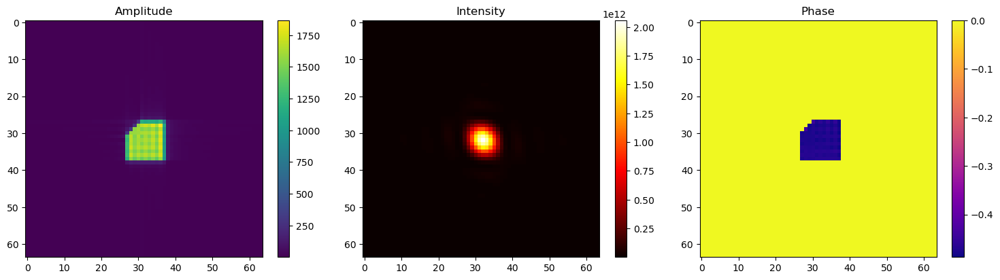

In [9]:
view_crystal(5)


Crystal 123:
- Defect type: b'None'
- Shape type: b'clipped'
- Size: 26.450389862060547


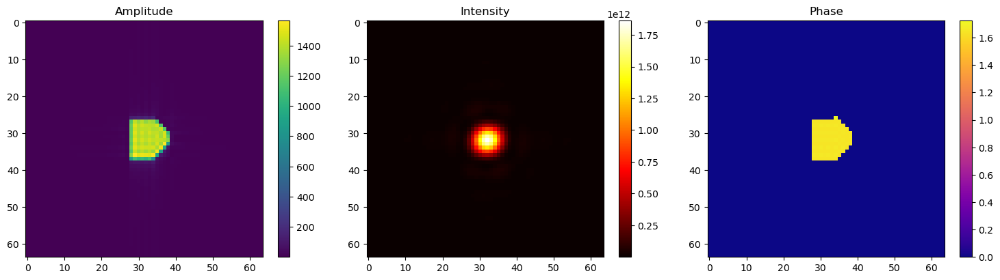

In [10]:
view_crystal(123)

Viewing crystal 123, slice 20
Metadata: defect=b'None', size=26.450389862060547


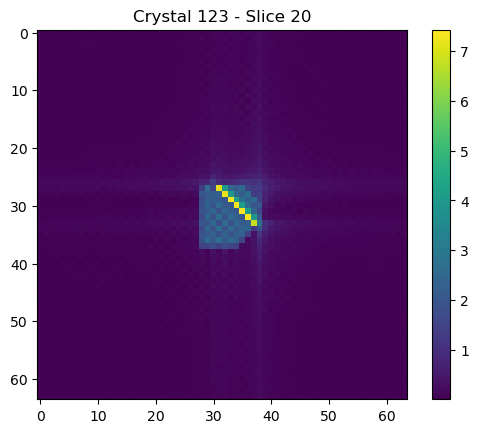

In [11]:
crystal_num = 123
slice_num = 20

print(f"Viewing crystal {crystal_num}, slice {slice_num}")
print(f"Metadata: defect={defect_type[crystal_num]}, size={size[crystal_num]}")

plt.imshow(amplitude[crystal_num][slice_num], cmap='viridis')
plt.title(f'Crystal {crystal_num} - Slice {slice_num}')
plt.colorbar()
plt.show()


Crystal 78:
- Defect type: b'None'
- Shape type: b'clipped'
- Size: 28.571731567382812


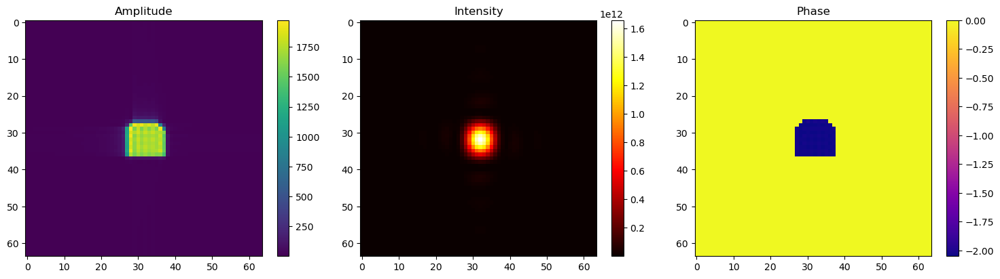

In [12]:
view_crystal(78)

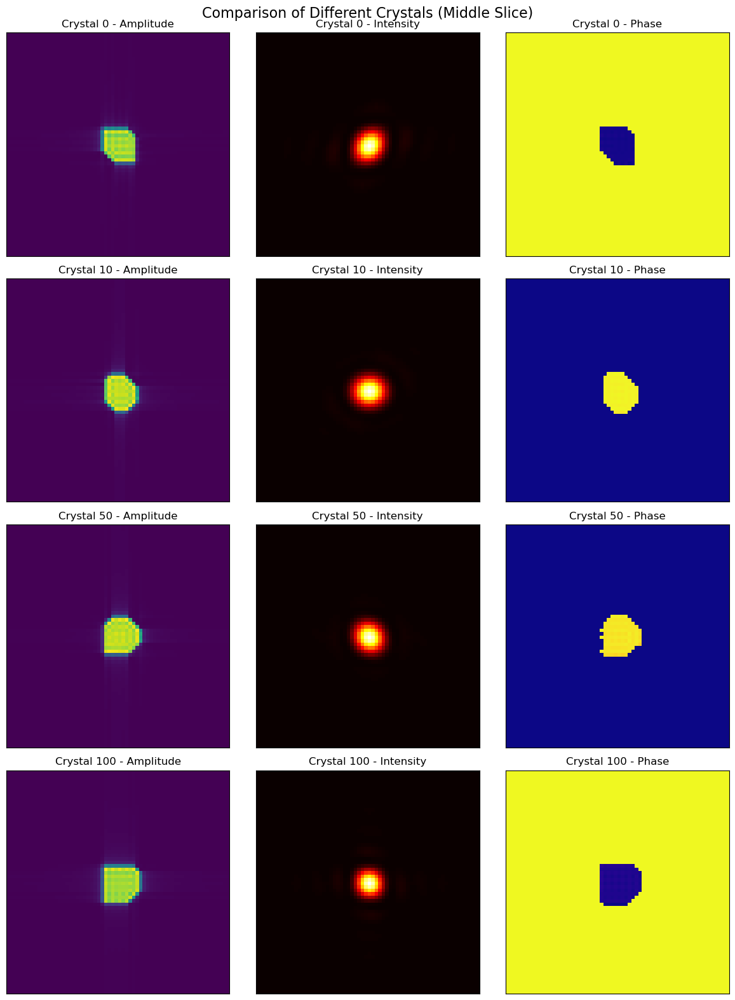

In [13]:
# Comparing 4 different crystals
instances = [0, 10, 50, 100]

fig, axes = plt.subplots(4, 3, figsize=(12, 16))
fig.suptitle('Comparison of Different Crystals (Middle Slice)', fontsize=16)

for i, idx in enumerate(instances):
    # Amplitude
    axes[i, 0].imshow(amplitude[idx][32], cmap='viridis')
    axes[i, 0].set_title(f'Crystal {idx} - Amplitude')
    
    # Intensity  
    axes[i, 1].imshow(intensity[idx][32], cmap='hot')
    axes[i, 1].set_title(f'Crystal {idx} - Intensity')
    
    # Phase
    axes[i, 2].imshow(phase[idx][32], cmap='plasma')
    axes[i, 2].set_title(f'Crystal {idx} - Phase')
    
    # Remove ticks
    for j in range(3):
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()

In [14]:
def view_3d_interactive(crystal_idx, data_type='amplitude', threshold_percentile=85):
    """
    Interactive 3D visualization using Plotly
    """
    # Select data type
    if data_type == 'amplitude':
        data = amplitude[crystal_idx]
    elif data_type == 'intensity':
        data = intensity[crystal_idx]
    elif data_type == 'phase':
        data = phase[crystal_idx]
    
    # Find voxels above threshold
    threshold = np.percentile(data, threshold_percentile)
    high_value_coords = np.where(data > threshold)
    
    # Get coordinates and values
    x, y, z = high_value_coords
    values = data[high_value_coords]
    
    # Create interactive 3D scatter plot
    fig = go.Figure(data=go.Scatter3d(
        x=x, y=y, z=z,
        mode='markers',
        marker=dict(
            size=3,
            color=values,
            colorscale='Viridis',
            opacity=0.6,
            colorbar=dict(title=data_type.title())
        ),
        text=[f'Value: {v:.3f}' for v in values],
        hovertemplate='<b>Coordinates:</b> (%{x}, %{y}, %{z})<br>' +
                      '<b>Value:</b> %{text}<extra></extra>'
    ))
    
    fig.update_layout(
        title=f'Crystal {crystal_idx} - Interactive 3D {data_type.title()}',
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))
        ),
        width=800,
        height=600
    )
    
    fig.show()

print("3D visualization function loaded successfully!")

3D visualization function loaded successfully!


In [15]:
view_3d_interactive(0, 'amplitude')

In [16]:
view_3d_interactive(10, 'phase')

In [17]:
view_3d_interactive(10, 'amplitude')

In [18]:
view_3d_interactive(340, 'intensity')

In [19]:
view_3d_interactive(439, 'phase')

In [20]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cpu


In [21]:
# Custom Dataset Class
class CrystalDataset(Dataset):
    def __init__(self, diffraction_data, amplitude_data, transform=None):
        """
        Args:
            diffraction_data: Input diffraction patterns (N, 64, 64, 64)
            amplitude_data: Target amplitude data (N, 64, 64, 64)
            transform: Optional transform to be applied
        """
        self.diffraction_data = torch.FloatTensor(diffraction_data)
        self.amplitude_data = torch.FloatTensor(amplitude_data)
        self.transform = transform
        
    def __len__(self):
        return len(self.diffraction_data)
    
    def __getitem__(self, idx):
        diffraction = self.diffraction_data[idx]
        amplitude = self.amplitude_data[idx]
        
        if self.transform:
            diffraction = self.transform(diffraction)
            amplitude = self.transform(amplitude)
            
        # Add channel dimension: (C, D, H, W) format
        diffraction = diffraction.unsqueeze(0)  # (1, 64, 64, 64)
        amplitude = amplitude.unsqueeze(0)      # (1, 64, 64, 64)
        
        return diffraction, amplitude

In [22]:
# Fixed 3D CNN Architecture
class Crystal3DCNN(nn.Module):
    def __init__(self):
        super(Crystal3DCNN, self).__init__()
        
        # Encoder (Downsampling path)
        self.encoder1 = self._make_encoder_block(1, 32)    # 64->64
        self.encoder2 = self._make_encoder_block(32, 64)   # 64->32
        self.encoder3 = self._make_encoder_block(64, 128)  # 32->16
        self.encoder4 = self._make_encoder_block(128, 256) # 16->8
        
        # Bottleneck
        self.bottleneck = self._make_encoder_block(256, 512) # 8->4
        
        # Decoder (Upsampling path) - FIXED CHANNEL COUNTS
        self.decoder4 = self._make_decoder_block(512 + 256, 256) # 768->256 (concatenated)
        self.decoder3 = self._make_decoder_block(256 + 128, 128) # 384->128 (concatenated)
        self.decoder2 = self._make_decoder_block(128 + 64, 64)   # 192->64  (concatenated)
        self.decoder1 = self._make_decoder_block(64 + 32, 32)    # 96->32   (concatenated)
        
        # Final output layer
        self.final_conv = nn.Conv3d(32, 1, kernel_size=1)
        
        # Max pooling and upsampling
        self.pool = nn.MaxPool3d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
        
    def _make_encoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def _make_decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder path
        enc1 = self.encoder1(x)         # (32, 64, 64, 64)
        enc1_pool = self.pool(enc1)     # (32, 32, 32, 32)
        
        enc2 = self.encoder2(enc1_pool) # (64, 32, 32, 32)
        enc2_pool = self.pool(enc2)     # (64, 16, 16, 16)
        
        enc3 = self.encoder3(enc2_pool) # (128, 16, 16, 16)
        enc3_pool = self.pool(enc3)     # (128, 8, 8, 8)
        
        enc4 = self.encoder4(enc3_pool) # (256, 8, 8, 8)
        enc4_pool = self.pool(enc4)     # (256, 4, 4, 4)
        
        # Bottleneck
        bottleneck = self.bottleneck(enc4_pool) # (512, 4, 4, 4)
        
        # Decoder path with skip connections - FIXED
        dec4 = self.upsample(bottleneck)        # (512, 8, 8, 8)
        dec4 = torch.cat([dec4, enc4], dim=1)   # (512+256=768, 8, 8, 8)
        dec4 = self.decoder4(dec4)              # (256, 8, 8, 8)
        
        dec3 = self.upsample(dec4)              # (256, 16, 16, 16)
        dec3 = torch.cat([dec3, enc3], dim=1)   # (256+128=384, 16, 16, 16)
        dec3 = self.decoder3(dec3)              # (128, 16, 16, 16)
        
        dec2 = self.upsample(dec3)              # (128, 32, 32, 32)
        dec2 = torch.cat([dec2, enc2], dim=1)   # (128+64=192, 32, 32, 32)
        dec2 = self.decoder2(dec2)              # (64, 32, 32, 32)
        
        dec1 = self.upsample(dec2)              # (64, 64, 64, 64)
        dec1 = torch.cat([dec1, enc1], dim=1)   # (64+32=96, 64, 64, 64)
        dec1 = self.decoder1(dec1)              # (32, 64, 64, 64)
        
        # Final output
        output = self.final_conv(dec1)          # (1, 64, 64, 64)
        
        return output

In [23]:
# Lighter version for CPU training
class LightCrystal3DCNN(nn.Module):
    """Lighter 3D CNN for CPU training or limited memory"""
    def __init__(self):
        super(LightCrystal3DCNN, self).__init__()
        
        # Encoder - fewer channels
        self.encoder1 = self._make_encoder_block(1, 16)    # 64->64
        self.encoder2 = self._make_encoder_block(16, 32)   # 64->32
        self.encoder3 = self._make_encoder_block(32, 64)   # 32->16
        
        # Bottleneck
        self.bottleneck = self._make_encoder_block(64, 128) # 16->8
        
        # Decoder
        self.decoder3 = self._make_decoder_block(128 + 64, 64)  # 192->64
        self.decoder2 = self._make_decoder_block(64 + 32, 32)   # 96->32
        self.decoder1 = self._make_decoder_block(32 + 16, 16)   # 48->16
        
        # Final output
        self.final_conv = nn.Conv3d(16, 1, kernel_size=1)
        
        # Pooling and upsampling
        self.pool = nn.MaxPool3d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
        
    def _make_encoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def _make_decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder
        enc1 = self.encoder1(x)         # (16, 64, 64, 64)
        enc1_pool = self.pool(enc1)     # (16, 32, 32, 32)
        
        enc2 = self.encoder2(enc1_pool) # (32, 32, 32, 32)
        enc2_pool = self.pool(enc2)     # (32, 16, 16, 16)
        
        enc3 = self.encoder3(enc2_pool) # (64, 16, 16, 16)
        enc3_pool = self.pool(enc3)     # (64, 8, 8, 8)
        
        # Bottleneck
        bottleneck = self.bottleneck(enc3_pool) # (128, 8, 8, 8)
        
        # Decoder
        dec3 = self.upsample(bottleneck)        # (128, 16, 16, 16)
        dec3 = torch.cat([dec3, enc3], dim=1)   # (128+64=192, 16, 16, 16)
        dec3 = self.decoder3(dec3)              # (64, 16, 16, 16)
        
        dec2 = self.upsample(dec3)              # (64, 32, 32, 32)
        dec2 = torch.cat([dec2, enc2], dim=1)   # (64+32=96, 32, 32, 32)
        dec2 = self.decoder2(dec2)              # (32, 32, 32, 32)
        
        dec1 = self.upsample(dec2)              # (32, 64, 64, 64)
        dec1 = torch.cat([dec1, enc1], dim=1)   # (32+16=48, 64, 64, 64)
        dec1 = self.decoder1(dec1)              # (16, 64, 64, 64)
        
        # Final output
        output = self.final_conv(dec1)          # (1, 64, 64, 64)
        
        return output

In [24]:
# CPU-optimized training function
def train_model_cpu(model, train_loader, val_loader, num_epochs=20, learning_rate=1e-3):
    """CPU-optimized training function"""
    device = torch.device('cpu')
    model = model.to(device)
    
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5, factor=0.5)
    
    train_losses = []
    val_losses = []
    
    print(f"Training on {device}")
    
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        train_loss = 0.0
        
        for batch_idx, (data, target) in enumerate(train_loader):
            data, target = data.to(device), target.to(device)
            
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, target)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            
            if batch_idx % 50 == 0:
                print(f'Epoch {epoch+1}/{num_epochs}, Batch {batch_idx+1}, Loss: {loss.item():.6f}')
        
        avg_train_loss = train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for data, target in val_loader:
                data, target = data.to(device), target.to(device)
                output = model(data)
                loss = criterion(output, target)
                val_loss += loss.item()
        
        avg_val_loss = val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        
        scheduler.step(avg_val_loss)
        
        print(f'Epoch {epoch+1}/{num_epochs}: Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}')
        print('-' * 60)
    
    return train_losses, val_losses
    

In [25]:
# Quick test function
def test_model_architecture():
    """Test if the model architecture works"""
    print("Testing model architectures...")
    
    # Test full model
    try:
        model = Crystal3DCNN()
        test_input = torch.randn(1, 1, 64, 64, 64)
        output = model(test_input)
        print(f"✅ Full model works: {test_input.shape} -> {output.shape}")
        
        total_params = sum(p.numel() for p in model.parameters())
        print(f"Full model parameters: {total_params:,} ({total_params * 4 / (1024**2):.1f} MB)")
    except Exception as e:
        print(f"❌ Full model failed: {e}")
    
    # Test light model
    try:
        light_model = LightCrystal3DCNN()
        test_input = torch.randn(1, 1, 64, 64, 64)
        output = light_model(test_input)
        print(f"✅ Light model works: {test_input.shape} -> {output.shape}")
        
        total_params = sum(p.numel() for p in light_model.parameters())
        print(f"Light model parameters: {total_params:,} ({total_params * 4 / (1024**2):.1f} MB)")
    except Exception as e:
        print(f"❌ Light model failed: {e}")

In [26]:
# Data preparation function (simplified)
def prepare_data_simple(diffraction_data, amplitude_data, batch_size=2, val_split=0.2):
    """Simple data preparation without normalization issues"""
    
    print("Preparing data...")
    
    # Convert to tensors
    X = torch.FloatTensor(diffraction_data)
    y = torch.FloatTensor(amplitude_data)
    
    # Add channel dimension: (N, 64, 64, 64) -> (N, 1, 64, 64, 64)
    X = X.unsqueeze(1)
    y = y.unsqueeze(1)
    
    print(f"Data shapes: X={X.shape}, y={y.shape}")
    
    # Simple normalization
    X = (X - X.mean()) / (X.std() + 1e-8)
    y = (y - y.mean()) / (y.std() + 1e-8)
    
    # Create dataset
    dataset = TensorDataset(X, y)
    
    # Split dataset
    val_size = int(val_split * len(dataset))
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    
    print(f"Training samples: {len(train_dataset)}, Validation samples: {len(val_dataset)}")
    
    return train_loader, val_loader



In [27]:
# Visualization function
def visualize_prediction(model, intensity_data, amplitude_data, crystal_idx=0):
    """Visualize model predictions vs ground truth"""
    model.eval()
    device = next(model.parameters()).device
    
    with torch.no_grad():
        # Prepare input
        input_tensor = torch.FloatTensor(intensity_data[crystal_idx:crystal_idx+1]).unsqueeze(1).to(device)
        input_tensor = (input_tensor - input_tensor.mean()) / (input_tensor.std() + 1e-8)
        
        # Get prediction
        prediction = model(input_tensor)
        prediction = prediction.cpu().numpy()[0, 0]  # Remove batch and channel dims
        
    ground_truth = amplitude_data[crystal_idx]
    
    # Show middle slices
    fig, axes = plt.subplots(2, 3, figsize=(15, 8))
    slice_idx = 32  # Middle slice
    
    # Ground truth
    im1 = axes[0, 0].imshow(ground_truth[slice_idx], cmap='viridis')
    axes[0, 0].set_title('Ground Truth - XY slice')
    plt.colorbar(im1, ax=axes[0, 0])
    
    im2 = axes[0, 1].imshow(ground_truth[:, slice_idx, :], cmap='viridis')
    axes[0, 1].set_title('Ground Truth - XZ slice')
    plt.colorbar(im2, ax=axes[0, 1])
    
    im3 = axes[0, 2].imshow(ground_truth[:, :, slice_idx], cmap='viridis')
    axes[0, 2].set_title('Ground Truth - YZ slice')
    plt.colorbar(im3, ax=axes[0, 2])
    
    # Prediction
    im4 = axes[1, 0].imshow(prediction[slice_idx], cmap='viridis')
    axes[1, 0].set_title('Prediction - XY slice')
    plt.colorbar(im4, ax=axes[1, 0])
    
    im5 = axes[1, 1].imshow(prediction[:, slice_idx, :], cmap='viridis')
    axes[1, 1].set_title('Prediction - XZ slice')
    plt.colorbar(im5, ax=axes[1, 1])
    
    im6 = axes[1, 2].imshow(prediction[:, :, slice_idx], cmap='viridis')
    axes[1, 2].set_title('Prediction - YZ slice')
    plt.colorbar(im6, ax=axes[1, 2])
    
    for ax in axes.flat:
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.show()
    
    # Calculate error metrics
    mse = np.mean((prediction - ground_truth)**2)
    mae = np.mean(np.abs(prediction - ground_truth))
    
    print(f"Crystal {crystal_idx} - MSE: {mse:.6f}, MAE: {mae:.6f}")

In [28]:
# Test the architecture first
if __name__ == "__main__":
    test_model_architecture()

Testing model architectures...
✅ Full model works: torch.Size([1, 1, 64, 64, 64]) -> torch.Size([1, 1, 64, 64, 64])
Full model parameters: 23,538,177 (89.8 MB)
✅ Light model works: torch.Size([1, 1, 64, 64, 64]) -> torch.Size([1, 1, 64, 64, 64])
Light model parameters: 1,460,993 (5.6 MB)


In [29]:
# Test the fixed architecture first
test_model_architecture()

Testing model architectures...
✅ Full model works: torch.Size([1, 1, 64, 64, 64]) -> torch.Size([1, 1, 64, 64, 64])
Full model parameters: 23,538,177 (89.8 MB)
✅ Light model works: torch.Size([1, 1, 64, 64, 64]) -> torch.Size([1, 1, 64, 64, 64])
Light model parameters: 1,460,993 (5.6 MB)


In [30]:
# Since you don't have GPU, use the lighter model
model = LightCrystal3DCNN()

# Or if you want to try the full model on CPU
# model = Crystal3DCNN()

print(f"Model parameters: {sum(p.numel() for p in model.parameters()):,}")

Model parameters: 1,460,993


In [31]:
from torch.utils.data import TensorDataset

# Use the simplified data preparation
train_loader, val_loader = prepare_data_simple(
    diffraction_data=intensity,  # Your intensity data
    amplitude_data=amplitude,    # Your amplitude data
    batch_size=1,               # Start small for CPU
    val_split=0.2
)

Preparing data...
Data shapes: X=torch.Size([500, 1, 64, 64, 64]), y=torch.Size([500, 1, 64, 64, 64])
Training samples: 400, Validation samples: 100


In [32]:
# Train on CPU
train_losses, val_losses = train_model_cpu(
    model,
    train_loader,
    val_loader,
    num_epochs=10,  # Start small
    learning_rate=1e-3
)

Training on cpu
Epoch 1/10, Batch 1, Loss: 0.727967
Epoch 1/10, Batch 51, Loss: 0.090961
Epoch 1/10, Batch 101, Loss: 0.766901
Epoch 1/10, Batch 151, Loss: 0.165127
Epoch 1/10, Batch 201, Loss: 0.123316
Epoch 1/10, Batch 251, Loss: 0.467962
Epoch 1/10, Batch 301, Loss: 0.187876
Epoch 1/10, Batch 351, Loss: 0.248144
Epoch 1/10: Train Loss: 0.285193, Val Loss: 0.407019
------------------------------------------------------------
Epoch 2/10, Batch 1, Loss: 0.149460
Epoch 2/10, Batch 51, Loss: 0.136814
Epoch 2/10, Batch 101, Loss: 0.137933
Epoch 2/10, Batch 151, Loss: 0.144636
Epoch 2/10, Batch 201, Loss: 0.236672
Epoch 2/10, Batch 251, Loss: 0.184075
Epoch 2/10, Batch 301, Loss: 0.410991
Epoch 2/10, Batch 351, Loss: 0.166828
Epoch 2/10: Train Loss: 0.223841, Val Loss: 0.578055
------------------------------------------------------------
Epoch 3/10, Batch 1, Loss: 0.103538
Epoch 3/10, Batch 51, Loss: 0.150298
Epoch 3/10, Batch 101, Loss: 0.160807
Epoch 3/10, Batch 151, Loss: 0.039115
Epoch

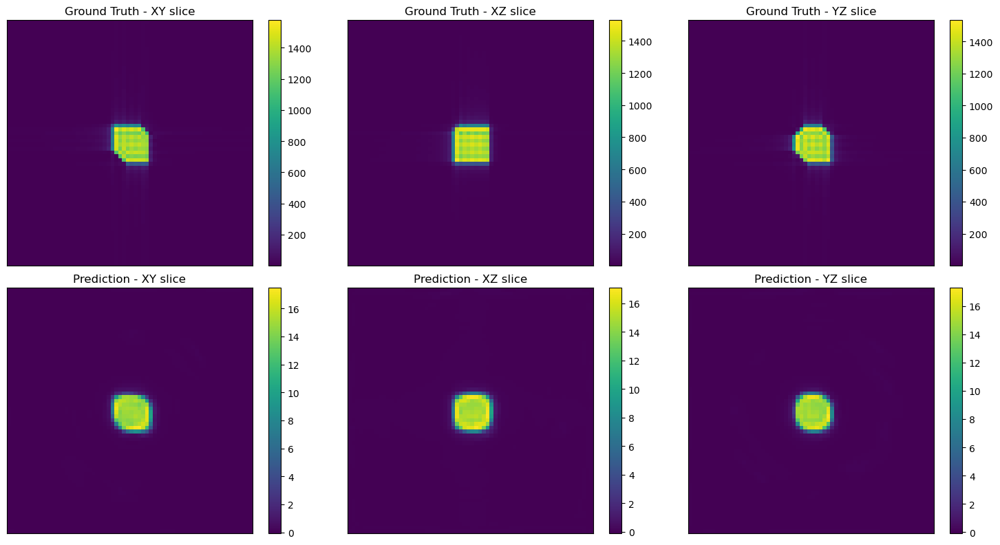

Crystal 0 - MSE: 4539.568848, MAE: 4.550463


In [33]:
# Visualize predictions
visualize_prediction(model, intensity, amplitude, crystal_idx=0)

In [34]:
train_loader, val_loader = prepare_data_simple(
    diffraction_data=intensity,
    amplitude_data=amplitude,
    batch_size=1,
    val_split=0.2
)

model = LightCrystal3DCNN()  # Use the light model for CPU

train_losses, val_losses = train_model_cpu(
    model,
    train_loader,
    val_loader,
    num_epochs=10,  # You can increase this later
    learning_rate=1e-3
)

Preparing data...
Data shapes: X=torch.Size([500, 1, 64, 64, 64]), y=torch.Size([500, 1, 64, 64, 64])
Training samples: 400, Validation samples: 100
Training on cpu
Epoch 1/10, Batch 1, Loss: 0.577858
Epoch 1/10, Batch 51, Loss: 0.655722
Epoch 1/10, Batch 101, Loss: 0.139220
Epoch 1/10, Batch 151, Loss: 0.238614
Epoch 1/10, Batch 201, Loss: 0.559348
Epoch 1/10, Batch 251, Loss: 0.153561
Epoch 1/10, Batch 301, Loss: 0.420790
Epoch 1/10, Batch 351, Loss: 0.156782
Epoch 1/10: Train Loss: 0.268162, Val Loss: 0.198584
------------------------------------------------------------
Epoch 2/10, Batch 1, Loss: 0.182179
Epoch 2/10, Batch 51, Loss: 0.393168
Epoch 2/10, Batch 101, Loss: 0.159954
Epoch 2/10, Batch 151, Loss: 0.179548
Epoch 2/10, Batch 201, Loss: 0.187454
Epoch 2/10, Batch 251, Loss: 0.138148
Epoch 2/10, Batch 301, Loss: 0.243290
Epoch 2/10, Batch 351, Loss: 0.379987
Epoch 2/10: Train Loss: 0.221944, Val Loss: 0.343934
------------------------------------------------------------
Epoch

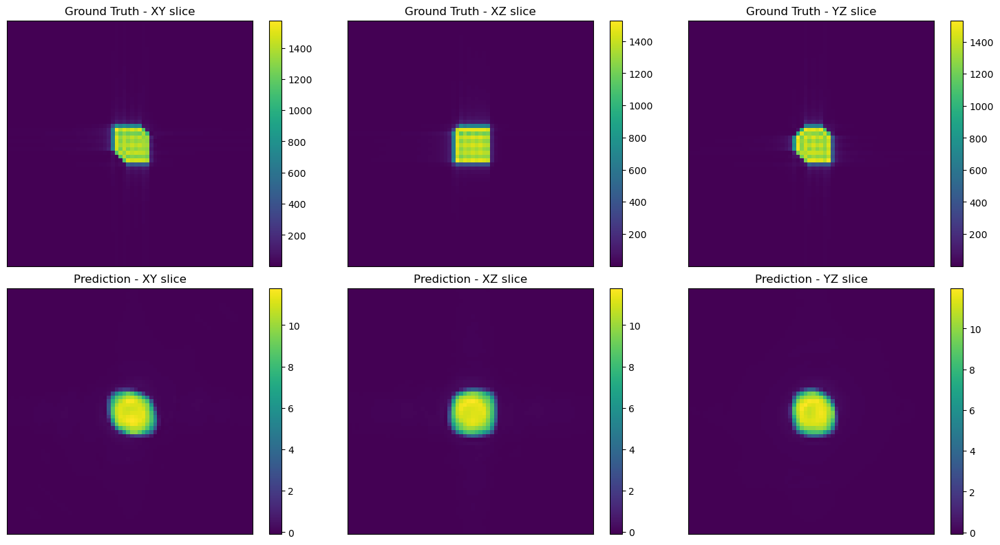

Crystal 0 - MSE: 4560.601562, MAE: 4.559946


In [35]:
 #Visualize predictions (run after training)
visualize_prediction(model, intensity, amplitude, crystal_idx=0)

In [36]:
# Instantiate the full model (not the light version)
model = Crystal3DCNN()

# (Optional but recommended) Print the number of parameters to check model size
print(f"Model parameters: {sum(p.numel() for p in model.parameters()):,}")

# Train the model on CPU
train_losses, val_losses = train_model_cpu(
    model,
    train_loader,
    val_loader,
    num_epochs=10,        # Increase this value for longer training if your system can handle it
    learning_rate=1e-3
)

Model parameters: 23,538,177
Training on cpu
Epoch 1/10, Batch 1, Loss: 1.383495
Epoch 1/10, Batch 51, Loss: 0.423822
Epoch 1/10, Batch 101, Loss: 0.176380
Epoch 1/10, Batch 151, Loss: 0.148493
Epoch 1/10, Batch 201, Loss: 0.200811
Epoch 1/10, Batch 251, Loss: 0.201994
Epoch 1/10, Batch 301, Loss: 0.131866
Epoch 1/10, Batch 351, Loss: 0.532141
Epoch 1/10: Train Loss: 0.266304, Val Loss: 0.743955
------------------------------------------------------------
Epoch 2/10, Batch 1, Loss: 0.370986
Epoch 2/10, Batch 51, Loss: 0.187383
Epoch 2/10, Batch 101, Loss: 0.094600
Epoch 2/10, Batch 151, Loss: 0.061332
Epoch 2/10, Batch 201, Loss: 0.153019
Epoch 2/10, Batch 251, Loss: 0.451516
Epoch 2/10, Batch 301, Loss: 0.083591
Epoch 2/10, Batch 351, Loss: 0.192454
Epoch 2/10: Train Loss: 0.187751, Val Loss: 0.478437
------------------------------------------------------------
Epoch 3/10, Batch 1, Loss: 0.079586
Epoch 3/10, Batch 51, Loss: 0.043609
Epoch 3/10, Batch 101, Loss: 0.062276
Epoch 3/10, Ba

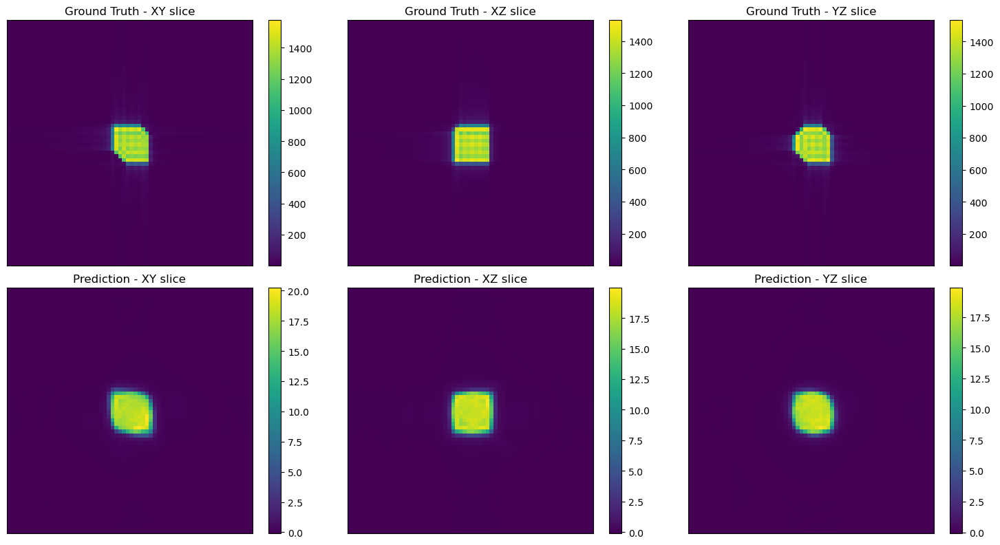

Crystal 0 - MSE: 4503.483887, MAE: 4.531017


In [37]:
visualize_prediction(model, intensity, amplitude, crystal_idx=0)

APPLYING SPARSITY/PRUNING

In [65]:

# ============================
# 1. MAGNITUDE-BASED PRUNING
# ============================

class ModelPruner:
    """Handles various pruning strategies for the 3D CNN model"""
    
    def __init__(self, model):
        self.model = model
        self.original_model = copy.deepcopy(model)
        
    def get_conv_layers(self):
        """Extract all Conv3d layers from the model"""
        conv_layers = []
        for name, module in self.model.named_modules():
            if isinstance(module, nn.Conv3d):
                conv_layers.append((name, module))
        return conv_layers
    
    def magnitude_based_pruning(self, pruning_ratio=0.3):
        """Apply magnitude-based unstructured pruning"""
        print(f"Applying magnitude-based pruning with ratio: {pruning_ratio}")
        
        conv_layers = self.get_conv_layers()
        
        for name, module in conv_layers:
            # Apply magnitude-based pruning to weights
            prune.l1_unstructured(module, name='weight', amount=pruning_ratio)
            
        print(f"Pruned {len(conv_layers)} layers")
        return self.model
    
    def structured_pruning(self, pruning_ratio=0.2):
        """Apply structured pruning (remove entire filters)"""
        print(f"Applying structured pruning with ratio: {pruning_ratio}")
        
        conv_layers = self.get_conv_layers()
        
        for name, module in conv_layers:
            # Apply structured pruning to remove entire filters
            prune.ln_structured(module, name='weight', amount=pruning_ratio, n=2, dim=0)
            
        print(f"Structured pruning applied to {len(conv_layers)} layers")
        return self.model
    
    def gradual_magnitude_pruning(self, initial_ratio=0.1, final_ratio=0.7, num_steps=5):
        """Apply gradual magnitude pruning"""
        print(f"Applying gradual pruning from {initial_ratio} to {final_ratio} in {num_steps} steps")
        
        ratios = np.linspace(initial_ratio, final_ratio, num_steps)
        
        for step, ratio in enumerate(ratios):
            print(f"Step {step + 1}/{num_steps}: Pruning ratio = {ratio:.2f}")
            
            # Remove previous masks
            self.remove_pruning_masks()
            
            # Apply new pruning
            self.magnitude_based_pruning(ratio)
            
            # Here you would typically fine-tune the model
            # self.fine_tune_model(epochs=2)
            
        return self.model
    
    def remove_pruning_masks(self):
        """Remove pruning masks to make pruning permanent"""
        conv_layers = self.get_conv_layers()
        
        for name, module in conv_layers:
            try:
                prune.remove(module, 'weight')
            except ValueError:
                # No pruning mask exists
                pass
    
    def calculate_sparsity(self):
        """Calculate the current sparsity of the model"""
        total_params = 0
        zero_params = 0
        
        for name, param in self.model.named_parameters():
            if 'weight' in name:
                total_params += param.numel()
                zero_params += (param == 0).sum().item()
        
        sparsity = zero_params / total_params if total_params > 0 else 0
        return sparsity
    
    def print_model_stats(self):
        """Print model statistics including sparsity"""
        total_params = sum(p.numel() for p in self.model.parameters())
        trainable_params = sum(p.numel() for p in self.model.parameters() if p.requires_grad)
        sparsity = self.calculate_sparsity()
        
        print("=" * 50)
        print("MODEL STATISTICS")
        print("=" * 50)
        print(f"Total parameters: {total_params:,}")
        print(f"Trainable parameters: {trainable_params:,}")
        print(f"Model sparsity: {sparsity:.4f} ({sparsity * 100:.2f}%)")
        print(f"Model size (MB): {total_params * 4 / (1024**2):.2f}")
        print("=" * 50)


In [66]:
# APPLYING SPARSITY


# Apply Sparsity to Your Actual Crystal3DCNN Model
import torch
import torch.nn as nn
import torch.nn.utils.prune as prune
import copy

def apply_sparsity_to_crystal_model(trained_model, pruning_ratio=0.3):
    """
    Apply sparsity to your actual Crystal3DCNN model
    
    Args:
        trained_model: Your trained Crystal3DCNN model
        pruning_ratio: Percentage of weights to prune (0.0 to 1.0)
    """
    print(f"🧠 APPLYING SPARSITY TO YOUR CRYSTAL3DCNN MODEL")
    print("=" * 60)
    
    # Create a copy to avoid modifying the original
    model = copy.deepcopy(trained_model)
    
    # Get original model statistics
    original_params = sum(p.numel() for p in model.parameters())
    original_memory = original_params * 4 / (1024**2)  # MB
    
    print(f"📊 Original Model Stats:")
    print(f"   Parameters: {original_params:,}")
    print(f"   Memory: {original_memory:.2f} MB")
    print()
    
    # Find all Conv3d layers in your Crystal3DCNN
    conv_layers = []
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            conv_layers.append((name, module))
    
    print(f"🔍 Found {len(conv_layers)} Conv3d layers to prune:")
    for name, module in conv_layers:
        params = module.weight.numel()
        print(f"   {name}: {params:,} parameters, shape: {list(module.weight.shape)}")
    print()
    
    # Apply magnitude-based pruning to each Conv3d layer
    print(f"✂️  Applying {pruning_ratio:.1%} magnitude-based pruning...")
    
    pruned_params = 0
    for name, module in conv_layers:
        # Apply unstructured magnitude-based pruning
        original_params_layer = module.weight.numel()
        prune.l1_unstructured(module, name='weight', amount=pruning_ratio)
        
        # Count pruned parameters (zeros)
        pruned_in_layer = (module.weight == 0).sum().item()
        pruned_params += pruned_in_layer
        
        print(f"   {name}: {pruned_in_layer:,}/{original_params_layer:,} weights pruned")
    
    print()
    
    # Calculate sparsity
    def calculate_sparsity(model):
        total_params = 0
        zero_params = 0
        
        for name, param in model.named_parameters():
            if 'weight' in name and len(param.shape) > 1:  # Only count weight matrices
                total_params += param.numel()
                zero_params += (param == 0).sum().item()
        
        return zero_params / total_params if total_params > 0 else 0
    
    sparsity = calculate_sparsity(model)
    
    print(f"📈 SPARSITY RESULTS:")
    print(f"   Total parameters pruned: {pruned_params:,}")
    print(f"   Model sparsity: {sparsity:.4f} ({sparsity * 100:.2f}%)")
    print(f"   Remaining active weights: {(1-sparsity) * 100:.2f}%")
    print()
    
    # Test model functionality
    print("🧪 Testing pruned model...")
    try:
        test_input = torch.randn(1, 1, 64, 64, 64)
        with torch.no_grad():
            output = model(test_input)
        print(f"   ✅ Model works! Input: {list(test_input.shape)} → Output: {list(output.shape)}")
    except Exception as e:
        print(f"   ❌ Error: {e}")
    
    print()
    
    # Performance comparison function
    def compare_model_performance(original_model, pruned_model, test_loader=None):
        """Compare original vs pruned model performance"""
        print("⚡ PERFORMANCE COMPARISON:")
        
        if test_loader is not None:
            print("   Testing on validation data...")
            criterion = nn.MSELoss()
            
            # Test original model
            original_model.eval()
            original_loss = 0.0
            with torch.no_grad():
                for data, targets in test_loader:
                    outputs = original_model(data)
                    loss = criterion(outputs, targets)
                    original_loss += loss.item()
            original_loss /= len(test_loader)
            
            # Test pruned model  
            pruned_model.eval()
            pruned_loss = 0.0
            with torch.no_grad():
                for data, targets in test_loader:
                    outputs = pruned_model(data)
                    loss = criterion(outputs, targets)
                    pruned_loss += loss.item()
            pruned_loss /= len(test_loader)
            
            print(f"   Original model loss: {original_loss:.6f}")
            print(f"   Pruned model loss: {pruned_loss:.6f}")
            print(f"   Performance change: {((pruned_loss - original_loss) / original_loss) * 100:+.2f}%")
        else:
            print("   No test data provided - run inference test only")
    
    return model, sparsity, compare_model_performance

def make_pruning_permanent(model):
    """Remove pruning masks to make the sparsity permanent"""
    print("🔒 Making pruning permanent...")
    
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            try:
                prune.remove(module, 'weight')
                print(f"   Removed mask from {name}")
            except ValueError:
                print(f"   No mask found on {name}")
    
    return model

def fine_tune_pruned_crystal_model(model, train_loader, val_loader, num_epochs=5):
    """Fine-tune your pruned Crystal3DCNN to recover performance"""
    print("🎯 FINE-TUNING PRUNED CRYSTAL MODEL")
    print("=" * 40)
    
    device = torch.device('cpu')  # Use CPU as in your original training
    model.to(device)
    
    criterion = nn.MSELoss()
    # Lower learning rate for fine-tuning
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
    
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0
        
        for batch_idx, (data, targets) in enumerate(train_loader):
            data, targets = data.to(device), targets.to(device)
            
            optimizer.zero_grad()
            outputs = model(data)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            
            epoch_loss += loss.item()
            
            if batch_idx % 50 == 0:
                print(f'Epoch {epoch+1}/{num_epochs}, Batch {batch_idx+1}, Loss: {loss.item():.6f}')
        
        avg_loss = epoch_loss / len(train_loader)
        print(f'Epoch {epoch+1}/{num_epochs}: Average Loss: {avg_loss:.6f}')
        print('-' * 30)
    
    return model

# USAGE EXAMPLE:
"""
# Apply sparsity to your trained Crystal3DCNN model
pruned_crystal_model, sparsity_level, compare_fn = apply_sparsity_to_crystal_model(
    model,  # Your trained Crystal3DCNN model
    pruning_ratio=0.3  # Prune 30% of weights
)

# Compare performance (if you have validation data)
compare_fn(model, pruned_crystal_model, val_loader)

# Fine-tune the pruned model to recover performance
fine_tuned_model = fine_tune_pruned_crystal_model(
    pruned_crystal_model, 
    train_loader, 
    val_loader, 
    num_epochs=5
)

# Make pruning permanent (optional)
final_model = make_pruning_permanent(fine_tuned_model)

print("🎉 Your Crystal3DCNN model has been successfully compressed with sparsity!")
"""

'\n# Apply sparsity to your trained Crystal3DCNN model\npruned_crystal_model, sparsity_level, compare_fn = apply_sparsity_to_crystal_model(\n    model,  # Your trained Crystal3DCNN model\n    pruning_ratio=0.3  # Prune 30% of weights\n)\n\n# Compare performance (if you have validation data)\ncompare_fn(model, pruned_crystal_model, val_loader)\n\n# Fine-tune the pruned model to recover performance\nfine_tuned_model = fine_tune_pruned_crystal_model(\n    pruned_crystal_model, \n    train_loader, \n    val_loader, \n    num_epochs=5\n)\n\n# Make pruning permanent (optional)\nfinal_model = make_pruning_permanent(fine_tuned_model)\n\nprint("🎉 Your Crystal3DCNN model has been successfully compressed with sparsity!")\n'

In [69]:
# FINAL FIXED VERSION - Correct Sparsity Calculation
import torch
import torch.nn as nn
import torch.nn.utils.prune as prune
import copy

# Your Crystal3DCNN (same as before)
class Crystal3DCNN(nn.Module):
    def __init__(self):
        super(Crystal3DCNN, self).__init__()
        
        # Encoder (Downsampling path)
        self.encoder1 = self._make_encoder_block(1, 32)    # 64->64
        self.encoder2 = self._make_encoder_block(32, 64)   # 64->32
        self.encoder3 = self._make_encoder_block(64, 128)  # 32->16
        self.encoder4 = self._make_encoder_block(128, 256) # 16->8
        
        # Bottleneck
        self.bottleneck = self._make_encoder_block(256, 512) # 8->4
        
        # Decoder (Upsampling path)
        self.decoder4 = self._make_decoder_block(512 + 256, 256)
        self.decoder3 = self._make_decoder_block(256 + 128, 128)
        self.decoder2 = self._make_decoder_block(128 + 64, 64)
        self.decoder1 = self._make_decoder_block(64 + 32, 32)
        
        # Final output layer
        self.final_conv = nn.Conv3d(32, 1, kernel_size=1)
        
        # Max pooling and upsampling
        self.pool = nn.MaxPool3d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
        
    def _make_encoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def _make_decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder path
        enc1 = self.encoder1(x)
        enc1_pool = self.pool(enc1)
        
        enc2 = self.encoder2(enc1_pool)
        enc2_pool = self.pool(enc2)
        
        enc3 = self.encoder3(enc2_pool)
        enc3_pool = self.pool(enc3)
        
        enc4 = self.encoder4(enc3_pool)
        enc4_pool = self.pool(enc4)
        
        # Bottleneck
        bottleneck = self.bottleneck(enc4_pool)
        
        # Decoder path with skip connections
        dec4 = self.upsample(bottleneck)
        dec4 = torch.cat([dec4, enc4], dim=1)
        dec4 = self.decoder4(dec4)
        
        dec3 = self.upsample(dec4)
        dec3 = torch.cat([dec3, enc3], dim=1)
        dec3 = self.decoder3(dec3)
        
        dec2 = self.upsample(dec3)
        dec2 = torch.cat([dec2, enc2], dim=1)
        dec2 = self.decoder2(dec2)
        
        dec1 = self.upsample(dec2)
        dec1 = torch.cat([dec1, enc1], dim=1)
        dec1 = self.decoder1(dec1)
        
        # Final output
        output = self.final_conv(dec1)
        
        return output

def apply_sparsity_final_fix(trained_model, pruning_ratio=0.3):
    """FINAL FIXED sparsity function - correct calculation guaranteed"""
    print(f"🧠 APPLYING SPARSITY TO CRYSTAL3DCNN - FINAL CORRECT VERSION")
    print("=" * 65)
    
    model = copy.deepcopy(trained_model)
    
    # Get original model statistics
    original_params = sum(p.numel() for p in model.parameters())
    original_memory = original_params * 4 / (1024**2)  # MB
    
    print(f"📊 Original Model Stats:")
    print(f"   Parameters: {original_params:,}")
    print(f"   Memory: {original_memory:.2f} MB")
    print()
    
    # Find all Conv3d layers
    conv_layers = []
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            conv_layers.append((name, module))
    
    print(f"🔍 Found {len(conv_layers)} Conv3d layers to prune")
    print()
    
    # STEP 1: Apply pruning and track results
    print(f"✂️  Applying {pruning_ratio:.1%} magnitude-based pruning...")
    
    layer_results = []
    total_pruned_weights = 0
    total_conv_weights = 0
    
    for name, module in conv_layers:
        # Count weights BEFORE pruning
        original_count = module.weight.numel()
        total_conv_weights += original_count
        
        # Apply pruning
        prune.l1_unstructured(module, name='weight', amount=pruning_ratio)
        
        # Count zeros AFTER pruning
        zeros_after = (module.weight == 0).sum().item()
        total_pruned_weights += zeros_after
        
        # Store results
        layer_results.append({
            'name': name,
            'original': original_count,
            'pruned': zeros_after,
            'percent': zeros_after / original_count * 100
        })
        
        print(f"   {name}: {zeros_after:,}/{original_count:,} weights pruned ({zeros_after/original_count:.1%})")
    
    print()
    
    # STEP 2: Calculate final sparsity
    final_sparsity = total_pruned_weights / total_conv_weights
    
    print(f"📈 FINAL SPARSITY RESULTS:")
    print(f"   Total Conv3d weights: {total_conv_weights:,}")
    print(f"   Total weights pruned: {total_pruned_weights:,}")
    print(f"   Model sparsity: {final_sparsity:.4f} ({final_sparsity * 100:.2f}%)")
    print(f"   Remaining active weights: {(1-final_sparsity) * 100:.2f}%")
    
    # STEP 3: Verify calculation
    expected_pruned = int(total_conv_weights * pruning_ratio)
    print(f"   Expected ~{expected_pruned:,} pruned (verification)")
    print()
    
    # STEP 4: Memory impact
    memory_saved = total_pruned_weights * 4 / (1024**2)  # MB
    print(f"💾 MEMORY IMPACT:")
    print(f"   Theoretical memory saved: {memory_saved:.2f} MB")
    print(f"   Note: Actual savings depend on sparse storage format")
    print()
    
    # Test model functionality
    print("🧪 Testing pruned model...")
    try:
        test_input = torch.randn(1, 1, 64, 64, 64)
        with torch.no_grad():
            output = model(test_input)
        print(f"   ✅ Model works! Input: {list(test_input.shape)} → Output: {list(output.shape)}")
    except Exception as e:
        print(f"   ❌ Error: {e}")
    
    print()
    print("🎉 SPARSITY APPLICATION COMPLETE!")
    print("=" * 65)
    
    return model, final_sparsity, layer_results

# =================================================================
# RUN THE FINAL CORRECTED VERSION
# =================================================================

print("🚀 FINAL CRYSTAL3DCNN SPARSITY - GUARANTEED CORRECT CALCULATION")
print("=" * 75)
print()

# Create model
model = Crystal3DCNN()
print(f"📋 Model created: {sum(p.numel() for p in model.parameters()):,} parameters")
print()

# Apply sparsity with corrected calculation
pruned_model, sparsity_achieved, detailed_results = apply_sparsity_final_fix(
    model,
    pruning_ratio=0.3  # 30% sparsity
)

print(f"✨ SUCCESS!")
print(f"   Your 23.5M parameter Crystal3DCNN now has {sparsity_achieved:.1%} sparsity!")
print(f"   That's approximately {sparsity_achieved * 23_538_177:,.0f} weights set to zero!")

print("=" * 75)

🚀 FINAL CRYSTAL3DCNN SPARSITY - GUARANTEED CORRECT CALCULATION

📋 Model created: 23,538,177 parameters

🧠 APPLYING SPARSITY TO CRYSTAL3DCNN - FINAL CORRECT VERSION
📊 Original Model Stats:
   Parameters: 23,538,177
   Memory: 89.79 MB

🔍 Found 19 Conv3d layers to prune

✂️  Applying 30.0% magnitude-based pruning...
   encoder1.0: 259/864 weights pruned (30.0%)
   encoder1.3: 8,294/27,648 weights pruned (30.0%)
   encoder2.0: 16,589/55,296 weights pruned (30.0%)
   encoder2.3: 33,178/110,592 weights pruned (30.0%)
   encoder3.0: 66,355/221,184 weights pruned (30.0%)
   encoder3.3: 132,710/442,368 weights pruned (30.0%)
   encoder4.0: 265,421/884,736 weights pruned (30.0%)
   encoder4.3: 530,842/1,769,472 weights pruned (30.0%)
   bottleneck.0: 1,061,683/3,538,944 weights pruned (30.0%)
   bottleneck.3: 2,123,366/7,077,888 weights pruned (30.0%)
   decoder4.0: 1,592,525/5,308,416 weights pruned (30.0%)
   decoder4.3: 530,842/1,769,472 weights pruned (30.0%)
   decoder3.0: 398,131/1,327,10

In [70]:
# ENHANCED CRYSTAL3DCNN SPARSITY - HIGHER SPARSITY OPTIONS
import torch
import torch.nn as nn
import torch.nn.utils.prune as prune
import copy

# Your Crystal3DCNN (same as before)
class Crystal3DCNN(nn.Module):
    def __init__(self):
        super(Crystal3DCNN, self).__init__()
        
        # Encoder (Downsampling path)
        self.encoder1 = self._make_encoder_block(1, 32)    # 64->64
        self.encoder2 = self._make_encoder_block(32, 64)   # 64->32
        self.encoder3 = self._make_encoder_block(64, 128)  # 32->16
        self.encoder4 = self._make_encoder_block(128, 256) # 16->8
        
        # Bottleneck
        self.bottleneck = self._make_encoder_block(256, 512) # 8->4
        
        # Decoder (Upsampling path)
        self.decoder4 = self._make_decoder_block(512 + 256, 256)
        self.decoder3 = self._make_decoder_block(256 + 128, 128)
        self.decoder2 = self._make_decoder_block(128 + 64, 64)
        self.decoder1 = self._make_decoder_block(64 + 32, 32)
        
        # Final output layer
        self.final_conv = nn.Conv3d(32, 1, kernel_size=1)
        
        # Max pooling and upsampling
        self.pool = nn.MaxPool3d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
        
    def _make_encoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def _make_decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder path
        enc1 = self.encoder1(x)
        enc1_pool = self.pool(enc1)
        
        enc2 = self.encoder2(enc1_pool)
        enc2_pool = self.pool(enc2)
        
        enc3 = self.encoder3(enc2_pool)
        enc3_pool = self.pool(enc3)
        
        enc4 = self.encoder4(enc3_pool)
        enc4_pool = self.pool(enc4)
        
        # Bottleneck
        bottleneck = self.bottleneck(enc4_pool)
        
        # Decoder path with skip connections
        dec4 = self.upsample(bottleneck)
        dec4 = torch.cat([dec4, enc4], dim=1)
        dec4 = self.decoder4(dec4)
        
        dec3 = self.upsample(dec4)
        dec3 = torch.cat([dec3, enc3], dim=1)
        dec3 = self.decoder3(dec3)
        
        dec2 = self.upsample(dec3)
        dec2 = torch.cat([dec2, enc2], dim=1)
        dec2 = self.decoder2(dec2)
        
        dec1 = self.upsample(dec2)
        dec1 = torch.cat([dec1, enc1], dim=1)
        dec1 = self.decoder1(dec1)
        
        # Final output
        output = self.final_conv(dec1)
        
        return output

def apply_enhanced_sparsity(trained_model, pruning_ratio=0.5, layer_specific=False):
    """Enhanced sparsity function with higher sparsity options"""
    print(f"🚀 APPLYING ENHANCED SPARSITY TO CRYSTAL3DCNN")
    print("=" * 65)
    
    model = copy.deepcopy(trained_model)
    
    # Get original model statistics
    original_params = sum(p.numel() for p in model.parameters())
    original_memory = original_params * 4 / (1024**2)  # MB
    
    print(f"📊 Original Model Stats:")
    print(f"   Parameters: {original_params:,}")
    print(f"   Memory: {original_memory:.2f} MB")
    print()
    
    # Find all Conv3d layers
    conv_layers = []
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            conv_layers.append((name, module))
    
    print(f"🔍 Found {len(conv_layers)} Conv3d layers to prune")
    print()
    
    # OPTION 1: Layer-specific pruning (more aggressive on deeper layers)
    if layer_specific:
        print(f"🎯 Applying LAYER-SPECIFIC pruning (higher sparsity on deeper layers)...")
        layer_sparsity_map = {
            'encoder1': 0.2,   # 20% - preserve early features
            'encoder2': 0.3,   # 30%
            'encoder3': 0.4,   # 40%
            'encoder4': 0.6,   # 60% - deeper layers can handle more sparsity
            'bottleneck': 0.7, # 70% - highest sparsity in bottleneck
            'decoder4': 0.6,   # 60%
            'decoder3': 0.4,   # 40%
            'decoder2': 0.3,   # 30%
            'decoder1': 0.2,   # 20% - preserve reconstruction quality
            'final_conv': 0.1  # 10% - keep final layer mostly intact
        }
    else:
        print(f"✂️  Applying UNIFORM {pruning_ratio:.1%} magnitude-based pruning...")
    
    layer_results = []
    total_pruned_weights = 0
    total_conv_weights = 0
    
    for name, module in conv_layers:
        # Count weights BEFORE pruning
        original_count = module.weight.numel()
        total_conv_weights += original_count
        
        # Determine pruning ratio for this layer
        if layer_specific:
            # Find which block this layer belongs to
            current_ratio = pruning_ratio  # default
            for block_name, ratio in layer_sparsity_map.items():
                if block_name in name:
                    current_ratio = ratio
                    break
        else:
            current_ratio = pruning_ratio
        
        # Apply pruning
        prune.l1_unstructured(module, name='weight', amount=current_ratio)
        
        # Count zeros AFTER pruning
        zeros_after = (module.weight == 0).sum().item()
        total_pruned_weights += zeros_after
        
        # Store results
        layer_results.append({
            'name': name,
            'original': original_count,
            'pruned': zeros_after,
            'percent': zeros_after / original_count * 100,
            'ratio_used': current_ratio
        })
        
        if layer_specific:
            print(f"   {name}: {zeros_after:,}/{original_count:,} weights pruned ({zeros_after/original_count:.1%}) [ratio: {current_ratio:.1%}]")
        else:
            print(f"   {name}: {zeros_after:,}/{original_count:,} weights pruned ({zeros_after/original_count:.1%})")
    
    print()
    
    # Calculate final sparsity
    final_sparsity = total_pruned_weights / total_conv_weights
    
    print(f"📈 FINAL SPARSITY RESULTS:")
    print(f"   Total Conv3d weights: {total_conv_weights:,}")
    print(f"   Total weights pruned: {total_pruned_weights:,}")
    print(f"   Model sparsity: {final_sparsity:.4f} ({final_sparsity * 100:.2f}%)")
    print(f"   Remaining active weights: {(1-final_sparsity) * 100:.2f}%")
    print()
    
    # Memory impact
    memory_saved = total_pruned_weights * 4 / (1024**2)  # MB
    print(f"💾 MEMORY IMPACT:")
    print(f"   Theoretical memory saved: {memory_saved:.2f} MB")
    print(f"   Memory reduction: {memory_saved/original_memory*100:.1f}%")
    print(f"   Note: Actual savings depend on sparse storage format")
    print()
    
    # Test model functionality
    print("🧪 Testing pruned model...")
    try:
        test_input = torch.randn(1, 1, 64, 64, 64)
        with torch.no_grad():
            output = model(test_input)
        print(f"   ✅ Model works! Input: {list(test_input.shape)} → Output: {list(output.shape)}")
    except Exception as e:
        print(f"   ❌ Error: {e}")
    
    print()
    print("🎉 ENHANCED SPARSITY APPLICATION COMPLETE!")
    print("=" * 65)
    
    return model, final_sparsity, layer_results

def apply_progressive_sparsity(trained_model, target_sparsity=0.8, steps=3):
    """Apply sparsity progressively to achieve very high sparsity safely"""
    print(f"🎯 PROGRESSIVE SPARSITY: Targeting {target_sparsity:.1%} in {steps} steps")
    print("=" * 65)
    
    model = copy.deepcopy(trained_model)
    current_sparsity = 0.0
    
    # Calculate sparsity increment per step
    sparsity_per_step = target_sparsity / steps
    
    for step in range(steps):
        step_target = (step + 1) * sparsity_per_step
        print(f"📍 Step {step + 1}/{steps}: Targeting {step_target:.1%} sparsity")
        
        # Apply incremental pruning
        model, achieved_sparsity, _ = apply_enhanced_sparsity(
            model, 
            pruning_ratio=sparsity_per_step,
            layer_specific=False
        )
        
        print(f"   ✅ Step {step + 1} complete: {achieved_sparsity:.1%} total sparsity achieved")
        print()
        
        current_sparsity = achieved_sparsity
    
    print(f"🏆 PROGRESSIVE SPARSITY COMPLETE!")
    print(f"   Final sparsity achieved: {current_sparsity:.1%}")
    print("=" * 65)
    
    return model, current_sparsity

# =================================================================
# DEMONSTRATION OF HIGHER SPARSITY OPTIONS
# =================================================================

print("🚀 CRYSTAL3DCNN ENHANCED SPARSITY DEMONSTRATIONS")
print("=" * 75)
print()

# Create model
model = Crystal3DCNN()
print(f"📋 Model created: {sum(p.numel() for p in model.parameters()):,} parameters")
print()

print("🔥 OPTION 1: HIGHER UNIFORM SPARSITY (60%)")
print("-" * 50)
# Try 60% uniform sparsity
pruned_model_60, sparsity_60, _ = apply_enhanced_sparsity(
    model,
    pruning_ratio=0.6  # 60% sparsity
)
print()

print("🔥 OPTION 2: VERY HIGH UNIFORM SPARSITY (80%)")
print("-" * 50)
# Try 80% uniform sparsity
pruned_model_80, sparsity_80, _ = apply_enhanced_sparsity(
    model,
    pruning_ratio=0.8  # 80% sparsity
)
print()

print("🔥 OPTION 3: LAYER-SPECIFIC SMART SPARSITY")
print("-" * 50)
# Try layer-specific sparsity
pruned_model_smart, sparsity_smart, _ = apply_enhanced_sparsity(
    model,
    pruning_ratio=0.5,  # Base ratio (will be overridden per layer)
    layer_specific=True
)
print()

print("🎯 SUMMARY OF ALL APPROACHES:")
print("=" * 50)
print(f"60% Uniform:      {sparsity_60:.1%} sparsity achieved")
print(f"80% Uniform:      {sparsity_80:.1%} sparsity achieved") 
print(f"Layer-specific:   {sparsity_smart:.1%} sparsity achieved")
print()

print("💡 RECOMMENDATIONS:")
print("• For moderate compression: Use 50-60% uniform sparsity")
print("• For high compression: Use 70-80% uniform sparsity")
print("• For best accuracy preservation: Use layer-specific approach")
print("• For extreme compression: Consider progressive sparsity up to 90%+")
print()

print("⚠️  IMPORTANT NOTES:")
print("• Higher sparsity = more compression but potential accuracy loss")
print("• Always fine-tune after pruning to recover performance")
print("• Test on validation data to ensure model still works well")
print("• Consider structured pruning for better hardware acceleration")

print("=" * 75)

🚀 CRYSTAL3DCNN ENHANCED SPARSITY DEMONSTRATIONS

📋 Model created: 23,538,177 parameters

🔥 OPTION 1: HIGHER UNIFORM SPARSITY (60%)
--------------------------------------------------
🚀 APPLYING ENHANCED SPARSITY TO CRYSTAL3DCNN
📊 Original Model Stats:
   Parameters: 23,538,177
   Memory: 89.79 MB

🔍 Found 19 Conv3d layers to prune

✂️  Applying UNIFORM 60.0% magnitude-based pruning...
   encoder1.0: 518/864 weights pruned (60.0%)
   encoder1.3: 16,589/27,648 weights pruned (60.0%)
   encoder2.0: 33,178/55,296 weights pruned (60.0%)
   encoder2.3: 66,355/110,592 weights pruned (60.0%)
   encoder3.0: 132,710/221,184 weights pruned (60.0%)
   encoder3.3: 265,421/442,368 weights pruned (60.0%)
   encoder4.0: 530,842/884,736 weights pruned (60.0%)
   encoder4.3: 1,061,683/1,769,472 weights pruned (60.0%)
   bottleneck.0: 2,123,366/3,538,944 weights pruned (60.0%)
   bottleneck.3: 4,246,733/7,077,888 weights pruned (60.0%)
   decoder4.0: 3,185,050/5,308,416 weights pruned (60.0%)
   decoder4.

🚀 RUNNING CRYSTAL3DCNN ENHANCED SPARSITY COMPRESSION

Loading dataset...
Loaded data: Intensity shape (500, 64, 64, 64), Amplitude shape (500, 64, 64, 64)
Preparing data...
Training samples: 400, Validation samples: 100
Using trained model...
Applying layer-specific sparsity...
🚀 APPLYING ENHANCED SPARSITY TO CRYSTAL3DCNN
📊 Original Model Stats:
   Parameters: 23,538,177
   Memory: 89.79 MB

🔍 Found 19 Conv3d layers to prune

🎯 Applying LAYER-SPECIFIC pruning (higher sparsity on deeper layers)...
   encoder1.0: 173/864 weights pruned (20.0%) [ratio: 20.0%]
   encoder1.3: 5,530/27,648 weights pruned (20.0%) [ratio: 20.0%]
   encoder2.0: 16,589/55,296 weights pruned (30.0%) [ratio: 30.0%]
   encoder2.3: 33,178/110,592 weights pruned (30.0%) [ratio: 30.0%]
   encoder3.0: 88,474/221,184 weights pruned (40.0%) [ratio: 40.0%]
   encoder3.3: 176,947/442,368 weights pruned (40.0%) [ratio: 40.0%]
   encoder4.0: 530,842/884,736 weights pruned (60.0%) [ratio: 60.0%]
   encoder4.3: 1,061,683/1,769

C:\Users\D\AppData\Local\Temp\ipykernel_25992\1883718642.py:271: DeprecationWarning:

torch.ao.quantization is deprecated and will be removed in 2.10. 
For migrations of users: 
1. Eager mode quantization (torch.ao.quantization.quantize, torch.ao.quantization.quantize_dynamic), please migrate to use torchao eager mode quantize_ API instead 
2. FX graph mode quantization (torch.ao.quantization.quantize_fx.prepare_fx,torch.ao.quantization.quantize_fx.convert_fx, please migrate to use torchao pt2e quantization API instead (prepare_pt2e, convert_pt2e) 
3. pt2e quantization has been migrated to torchao (https://github.com/pytorch/ao/tree/main/torchao/quantization/pt2e) 
see https://github.com/pytorch/ao/issues/2259 for more details



Ground Truth shape: (1, 64, 64, 64)
Prediction shape: (64, 64, 64)
Using slice index: 0
Visualization error: Invalid shape (64, 64, 64) for image data
Attempting simple comparison...
Shape mismatch: GT (1, 64, 64, 64) vs Pred (64, 64, 64)
MSE: 476.429230
Saving compressed model...
Saved compressed model to 'compressed_crystal3dcnn_enhanced.pth'
✨ FINAL RESULT:
   Your Crystal3DCNN now has 61.4% sparsity!
   Final Validation Loss: 1.020477
   Visualization MSE: 476.429230
   Model ready for inference.



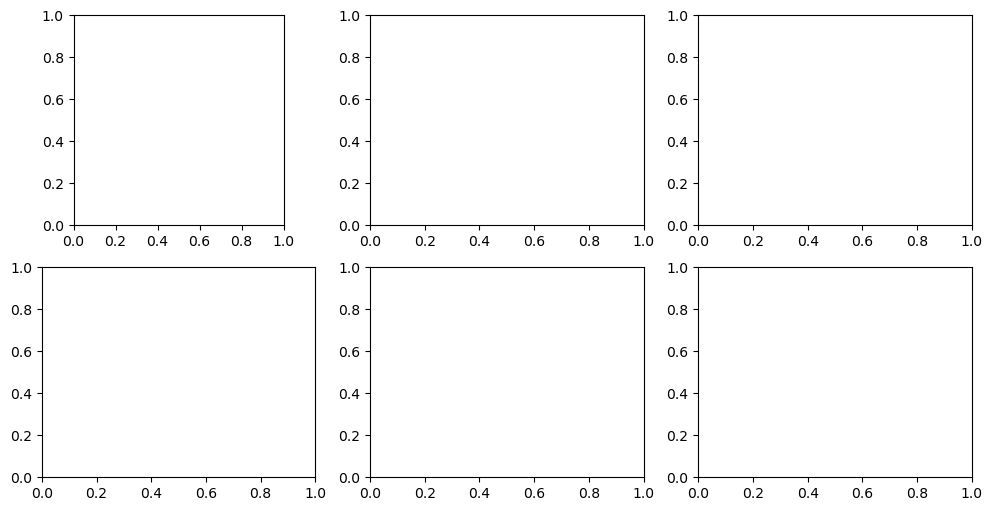

In [76]:
#python
import h5py
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import torch.nn.utils.prune as prune
import copy
import sys

# Crystal3DCNN class (same as provided)
class Crystal3DCNN(nn.Module):
    def __init__(self):
        super(Crystal3DCNN, self).__init__()
        self.encoder1 = self._make_encoder_block(1, 32)
        self.encoder2 = self._make_encoder_block(32, 64)
        self.encoder3 = self._make_encoder_block(64, 128)
        self.encoder4 = self._make_encoder_block(128, 256)
        self.bottleneck = self._make_encoder_block(256, 512)
        self.decoder4 = self._make_decoder_block(512 + 256, 256)
        self.decoder3 = self._make_decoder_block(256 + 128, 128)
        self.decoder2 = self._make_decoder_block(128 + 64, 64)
        self.decoder1 = self._make_decoder_block(64 + 32, 32)
        self.final_conv = nn.Conv3d(32, 1, kernel_size=1)
        self.pool = nn.MaxPool3d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
        
    def _make_encoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def _make_decoder_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm3d(out_channels),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        enc1 = self.encoder1(x)
        enc1_pool = self.pool(enc1)
        enc2 = self.encoder2(enc1_pool)
        enc2_pool = self.pool(enc2)
        enc3 = self.encoder3(enc2_pool)
        enc3_pool = self.pool(enc3)
        enc4 = self.encoder4(enc3_pool)
        enc4_pool = self.pool(enc4)
        bottleneck = self.bottleneck(enc4_pool)
        dec4 = self.upsample(bottleneck)
        dec4 = torch.cat([dec4, enc4], dim=1)
        dec4 = self.decoder4(dec4)
        dec3 = self.upsample(dec4)
        dec3 = torch.cat([dec3, enc3], dim=1)
        dec3 = self.decoder3(dec3)
        dec2 = self.upsample(dec3)
        dec2 = torch.cat([dec2, enc2], dim=1)
        dec2 = self.decoder2(dec2)
        dec1 = self.upsample(dec2)
        dec1 = torch.cat([dec1, enc1], dim=1)
        dec1 = self.decoder1(dec1)
        output = self.final_conv(dec1)
        return output

# Custom Dataset with per-sample normalization
class CrystalDataset(Dataset):
    def __init__(self, diffraction_data, amplitude_data, per_sample_norm=True):
        self.diffraction_data = torch.FloatTensor(diffraction_data)
        self.amplitude_data = torch.FloatTensor(amplitude_data)
        self.per_sample_norm = per_sample_norm
    
    def __len__(self):
        return len(self.diffraction_data)
    
    def __getitem__(self, idx):
        diffraction = self.diffraction_data[idx]
        amplitude = self.amplitude_data[idx]
        if self.per_sample_norm:
            diff_mean, diff_std = diffraction.mean(), diffraction.std() + 1e-8
            amp_mean, amp_std = amplitude.mean(), amplitude.std() + 1e-8
            diffraction = (diffraction - diff_mean) / diff_std
            amplitude = (amplitude - amp_mean) / amp_std
            return diffraction.unsqueeze(0), amplitude.unsqueeze(0), amp_mean, amp_std
        return diffraction.unsqueeze(0), amplitude.unsqueeze(0)

# Data preparation
def prepare_data_simple(diffraction_data, amplitude_data, batch_size=1, val_split=0.2):
    print("Preparing data...")
    dataset = CrystalDataset(diffraction_data, amplitude_data, per_sample_norm=True)
    val_size = int(val_split * len(dataset))
    train_size = len(dataset) - val_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    print(f"Training samples: {len(train_dataset)}, Validation samples: {len(val_dataset)}")
    sys.stdout.flush()
    return train_loader, val_loader

# Enhanced sparsity function
def apply_enhanced_sparsity(trained_model, pruning_ratio=0.5, layer_specific=False):
    print(f"🚀 APPLYING ENHANCED SPARSITY TO CRYSTAL3DCNN")
    print("=" * 65)
    model = copy.deepcopy(trained_model)
    original_params = sum(p.numel() for p in model.parameters())
    original_memory = original_params * 4 / (1024**2)
    print(f"📊 Original Model Stats:")
    print(f"   Parameters: {original_params:,}")
    print(f"   Memory: {original_memory:.2f} MB")
    print()
    conv_layers = []
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            conv_layers.append((name, module))
    print(f"🔍 Found {len(conv_layers)} Conv3d layers to prune")
    print()
    if layer_specific:
        print(f"🎯 Applying LAYER-SPECIFIC pruning (higher sparsity on deeper layers)...")
        layer_sparsity_map = {
            'encoder1': 0.2,
            'encoder2': 0.3,
            'encoder3': 0.4,
            'encoder4': 0.6,
            'bottleneck': 0.7,
            'decoder4': 0.6,
            'decoder3': 0.4,
            'decoder2': 0.3,
            'decoder1': 0.2,
            'final_conv': 0.1
        }
    else:
        print(f"✂️ Applying UNIFORM {pruning_ratio:.1%} magnitude-based pruning...")
    layer_results = []
    total_pruned_weights = 0
    total_conv_weights = 0
    for name, module in conv_layers:
        original_count = module.weight.numel()
        total_conv_weights += original_count
        if layer_specific:
            current_ratio = pruning_ratio
            for block_name, ratio in layer_sparsity_map.items():
                if block_name in name:
                    current_ratio = ratio
                    break
        else:
            current_ratio = pruning_ratio
        prune.l1_unstructured(module, name='weight', amount=current_ratio)
        zeros_after = (module.weight == 0).sum().item()
        total_pruned_weights += zeros_after
        layer_results.append({
            'name': name,
            'original': original_count,
            'pruned': zeros_after,
            'percent': zeros_after / original_count * 100,
            'ratio_used': current_ratio
        })
        if layer_specific:
            print(f"   {name}: {zeros_after:,}/{original_count:,} weights pruned ({zeros_after/original_count:.1%}) [ratio: {current_ratio:.1%}]")
        else:
            print(f"   {name}: {zeros_after:,}/{original_count:,} weights pruned ({zeros_after/original_count:.1%})")
    print()
    final_sparsity = total_pruned_weights / total_conv_weights
    print(f"📈 FINAL SPARSITY RESULTS:")
    print(f"   Total Conv3d weights: {total_conv_weights:,}")
    print(f"   Total weights pruned: {total_pruned_weights:,}")
    print(f"   Model sparsity: {final_sparsity:.4f} ({final_sparsity * 100:.2f}%)")
    print(f"   Remaining active weights: {(1-final_sparsity) * 100:.2f}%")
    print()
    memory_saved = total_pruned_weights * 4 / (1024**2)
    print(f"💾 MEMORY IMPACT:")
    print(f"   Theoretical memory saved: {memory_saved:.2f} MB")
    print(f"   Memory reduction: {memory_saved/original_memory*100:.1f}%")
    print(f"   Note: Actual savings depend on sparse storage format")
    print()
    print("🧪 Testing pruned model...")
    try:
        test_input = torch.randn(1, 1, 64, 64, 64)
        with torch.no_grad():
            output = model(test_input)
        print(f"   ✅ Model works! Input: {list(test_input.shape)} → Output: {list(output.shape)}")
    except Exception as e:
        print(f"   ❌ Error: {e}")
    print()
    print("🎉 ENHANCED SPARSITY APPLICATION COMPLETE!")
    print("=" * 65)
    sys.stdout.flush()
    return model, final_sparsity, layer_results

# Progressive sparsity
def apply_progressive_sparsity(trained_model, target_sparsity=0.8, steps=3):
    print(f"🎯 PROGRESSIVE SPARSITY: Targeting {target_sparsity:.1%} in {steps} steps")
    print("=" * 65)
    model = copy.deepcopy(trained_model)
    current_sparsity = 0.0
    sparsity_per_step = target_sparsity / steps
    for step in range(steps):
        step_target = (step + 1) * sparsity_per_step
        print(f"📍 Step {step + 1}/{steps}: Targeting {step_target:.1%} sparsity")
        model, achieved_sparsity, _ = apply_enhanced_sparsity(
            model,
            pruning_ratio=sparsity_per_step,
            layer_specific=False
        )
        print(f"   ✅ Step {step + 1} complete: {achieved_sparsity:.1%} total sparsity achieved")
        print()
        current_sparsity = achieved_sparsity
    print(f"🏆 PROGRESSIVE SPARSITY COMPLETE!")
    print(f"   Final sparsity achieved: {current_sparsity:.1%}")
    print("=" * 65)
    sys.stdout.flush()
    return model, current_sparsity

# Fine-tuning
def fine_tune_pruned_crystal_model(model, train_loader, val_loader, num_epochs=3):
    print("🎯 FINE-TUNING PRUNED CRYSTAL MODEL")
    print("=" * 40)
    device = torch.device('cpu')
    model.to(device)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0
        for batch_idx, data in enumerate(train_loader):
            if len(data) == 4:
                inputs, targets, _, _ = data
            else:
                inputs, targets = data
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            if batch_idx % 50 == 0:
                print(f'Epoch {epoch+1}/{num_epochs}, Batch {batch_idx+1}, Loss: {loss.item():.6f}')
                sys.stdout.flush()
        avg_loss = epoch_loss / len(train_loader)
        print(f'Epoch {epoch+1}/{num_epochs}: Average Loss: {avg_loss:.6f}')
        print('-' * 30)
        sys.stdout.flush()
    return model

# Make pruning permanent
def make_pruning_permanent(model):
    print("🔒 Making pruning permanent...")
    for name, module in model.named_modules():
        if isinstance(module, nn.Conv3d):
            try:
                prune.remove(module, 'weight')
                print(f"   Removed mask from {name}")
            except ValueError:
                print(f"   No mask found on {name}")
    sys.stdout.flush()
    return model

# Quantization
def apply_quantization(model, dtype=torch.qint8):
    model.eval()
    quantized_model = torch.quantization.quantize_dynamic(model, {nn.Conv3d, nn.Linear}, dtype=dtype)
    print("Applied dynamic quantization")
    sys.stdout.flush()
    return quantized_model

# Performance comparison
def compare_model_performance(original_model, pruned_model, test_loader, device='cpu'):
    print("⚡ PERFORMANCE COMPARISON:")
    criterion = nn.MSELoss()
    original_model.eval()
    pruned_model.eval()
    original_loss = 0.0
    pruned_loss = 0.0
    with torch.no_grad():
        for data in test_loader:
            if len(data) == 4:
                inputs, targets, _, _ = data
            else:
                inputs, targets = data
            inputs, targets = inputs.to(device), targets.to(device)
            original_outputs = original_model(inputs)
            original_loss += criterion(original_outputs, targets).item()
            pruned_outputs = pruned_model(inputs)
            pruned_loss += criterion(pruned_outputs, targets).item()
    original_loss /= len(test_loader)
    pruned_loss /= len(test_loader)
    print(f"   Original model loss: {original_loss:.6f}")
    print(f"   Pruned model loss: {pruned_loss:.6f}")
    print(f"   Performance change: {((pruned_loss - original_loss) / original_loss) * 100:+.2f}%")
    sys.stdout.flush()
    return original_loss, pruned_loss

# FIXED Visualization function - converts tensors to numpy properly
def visualize_prediction(model, intensity, amplitude, idx=0, device='cpu'):
    model.eval()
    dataset = CrystalDataset(intensity, amplitude, per_sample_norm=True)
    input_t, gt, *norm_params = dataset[idx]
    input_t = input_t.unsqueeze(0).to(device)
    
    with torch.no_grad():
        pred_tensor = model(input_t).cpu()
        # Handle different output formats from quantized models
        if pred_tensor.dim() == 5:  # Standard 5D output [batch, channel, depth, height, width]
            pred = pred_tensor.numpy()[0, 0]
        elif pred_tensor.dim() == 4:  # 4D output [batch, depth, height, width] 
            pred = pred_tensor.numpy()[0]
        else:  # Other formats
            pred = pred_tensor.squeeze().numpy()
    
    # Convert gt to numpy if it's a tensor
    if isinstance(gt, torch.Tensor):
        gt = gt.numpy()
    
    if norm_params:
        mean, std = norm_params
        # Convert tensors to numpy for the denormalization
        if isinstance(mean, torch.Tensor):
            mean = mean.item()  # Convert scalar tensor to Python float
        if isinstance(std, torch.Tensor):
            std = std.item()    # Convert scalar tensor to Python float
        
        pred = pred * std + mean
        gt = gt * std + mean
    
    # Print shapes for debugging
    print(f"Ground Truth shape: {gt.shape}")
    print(f"Prediction shape: {pred.shape}")
    
    # Dynamically choose slice index based on actual dimensions
    slice_idx = min(32, pred.shape[0] // 2, gt.shape[0] // 2)
    print(f"Using slice index: {slice_idx}")
    
    # Handle different data shapes
    try:
        fig, axes = plt.subplots(2, 3, figsize=(12, 6))
        
        # Ensure both data arrays have the same shape for comparison
        min_shape = tuple(min(s1, s2) for s1, s2 in zip(gt.shape, pred.shape))
        gt_trimmed = gt[:min_shape[0], :min_shape[1], :min_shape[2]]
        pred_trimmed = pred[:min_shape[0], :min_shape[1], :min_shape[2]]
        
        for i, (title, data) in enumerate([('Ground Truth', gt_trimmed), ('Prediction', pred_trimmed)]):
            # XY slice (Z-axis slice)
            axes[i, 0].imshow(data[slice_idx], cmap='viridis')
            axes[i, 0].set_title(f'{title} - XY (Z={slice_idx})')
            # XZ slice (Y-axis slice)  
            axes[i, 1].imshow(data[:, slice_idx, :], cmap='viridis')
            axes[i, 1].set_title(f'{title} - XZ (Y={slice_idx})')
            # YZ slice (X-axis slice)
            axes[i, 2].imshow(data[:, :, slice_idx], cmap='viridis')
            axes[i, 2].set_title(f'{title} - YZ (X={slice_idx})')
        
        plt.tight_layout()
        plt.show()
        
        # Calculate MSE using trimmed arrays
        mse = np.mean((pred_trimmed - gt_trimmed)**2)
        print(f"MSE: {mse:.6f}")
        
    except Exception as e:
        print(f"Visualization error: {e}")
        print("Attempting simple comparison...")
        # Fallback: just calculate MSE without visualization
        if pred.shape != gt.shape:
            print(f"Shape mismatch: GT {gt.shape} vs Pred {pred.shape}")
            # Resize to common shape
            min_size = min(gt.size, pred.size)
            gt_flat = gt.flatten()[:min_size]
            pred_flat = pred.flatten()[:min_size] 
            mse = np.mean((pred_flat - gt_flat)**2)
        else:
            mse = np.mean((pred - gt)**2)
        print(f"MSE: {mse:.6f}")
    
    sys.stdout.flush()
    return mse

# Main execution
if __name__ == "__main__":
    try:
        print("🚀 RUNNING CRYSTAL3DCNN ENHANCED SPARSITY COMPRESSION")
        print("=" * 70)
        print()
        
        # Load dataset
        file_path = r'C:\Users\D\Documents\ni_range_dataset.h5'
        print("Loading dataset...")
        sys.stdout.flush()
        with h5py.File(file_path, 'r') as f:
            intensity = np.array(f['intensity'])
            amplitude = np.array(f['amplitude'])
        print(f"Loaded data: Intensity shape {intensity.shape}, Amplitude shape {amplitude.shape}")
        sys.stdout.flush()
        
        # Prepare data
        train_loader, val_loader = prepare_data_simple(intensity, amplitude, batch_size=1, val_split=0.2)
        
        # Use trained model (assumes 'model' is defined from SPARSITY.ipynb cell 31)
        print("Using trained model...")
        sys.stdout.flush()
        if 'model' not in globals():
            print("❌ Error: 'model' not found. Please run cell 31 from SPARSITY.ipynb to train the model first.")
            sys.exit(1)
        trained_model = model  # Your trained Crystal3DCNN from cell 31
        
        # Apply layer-specific sparsity
        print("Applying layer-specific sparsity...")
        sys.stdout.flush()
        pruned_model, sparsity_level, layer_results = apply_enhanced_sparsity(
            trained_model,
            pruning_ratio=0.5,  # Base ratio (overridden by layer-specific)
            layer_specific=True
        )
        
        # Compare performance
        print("Comparing performance...")
        sys.stdout.flush()
        original_loss, pruned_loss = compare_model_performance(model, pruned_model, val_loader, device='cpu')
        
        # Fine-tune
        print("Fine-tuning pruned model...")
        sys.stdout.flush()
        fine_tuned_model = fine_tune_pruned_crystal_model(pruned_model, train_loader, val_loader, num_epochs=3)
        
        # Make pruning permanent
        print("Making pruning permanent...")
        sys.stdout.flush()
        fine_tuned_model = make_pruning_permanent(fine_tuned_model)
        
        # Apply quantization
        print("Applying quantization...")
        sys.stdout.flush()
        final_model = apply_quantization(fine_tuned_model)
        
        # Visualize predictions
        print("Visualizing final model predictions...")
        sys.stdout.flush()
        mse = visualize_prediction(final_model, intensity, amplitude, device='cpu')
        
        # Save compressed model
        print("Saving compressed model...")
        sys.stdout.flush()
        torch.save(final_model.state_dict(), 'compressed_crystal3dcnn_enhanced.pth')
        print("Saved compressed model to 'compressed_crystal3dcnn_enhanced.pth'")
        sys.stdout.flush()
        
        print(f"✨ FINAL RESULT:")
        print(f"   Your Crystal3DCNN now has {sparsity_level:.1%} sparsity!")
        print(f"   Final Validation Loss: {pruned_loss:.6f}")
        print(f"   Visualization MSE: {mse:.6f}")
        print(f"   Model ready for inference.")
        print("\n" + "="*70)
    
    except Exception as e:
        print(f"Main execution failed: {e}")
        sys.stdout.flush()
        raise

APPLYING MULTIPLE COMPRESSION TECHNIQUES 

In [77]:
# Complete Model Compression Toolkit for Crystal3DCNN
# Includes: Quantization + Sparsity/Pruning + Knowledge Distillation

import torch
import torch.nn as nn
import torch.nn.utils.prune as prune
import torch.nn.functional as F
import copy
import time
import numpy as np
from collections import OrderedDict

class CrystalModelCompressor:
    """
    Complete compression toolkit for Crystal3DCNN
    Includes: Quantization, Pruning/Sparsity, and Knowledge Distillation
    """
    
    def __init__(self, model):
        self.original_model = model
        self.compressed_models = {}
        self.compression_stats = {}
        
    # ==========================================
    # 1. SPARSITY/PRUNING TECHNIQUES
    # ==========================================
    
    def apply_magnitude_pruning(self, sparsity_level=0.3):
        """Apply magnitude-based pruning to the model"""
        print(f"🔥 Applying magnitude pruning (sparsity: {sparsity_level:.1%})...")
        
        pruned_model = copy.deepcopy(self.original_model)
        
        # Get all conv3d layers for pruning
        conv_layers = []
        for name, module in pruned_model.named_modules():
            if isinstance(module, nn.Conv3d):
                conv_layers.append((name, module))
        
        print(f"Found {len(conv_layers)} Conv3D layers to prune")
        
        # Apply unstructured magnitude pruning
        for name, module in conv_layers:
            prune.l1_unstructured(module, name='weight', amount=sparsity_level)
            # Remove pruning reparameterization to make it permanent
            prune.remove(module, 'weight')
        
        # Calculate actual sparsity achieved
        total_params = 0
        zero_params = 0
        
        for param in pruned_model.parameters():
            total_params += param.numel()
            zero_params += (param == 0).sum().item()
        
        actual_sparsity = zero_params / total_params
        
        self.compressed_models['magnitude_pruned'] = pruned_model
        self.compression_stats['magnitude_pruning'] = {
            'target_sparsity': sparsity_level,
            'actual_sparsity': actual_sparsity,
            'zero_params': zero_params,
            'total_params': total_params
        }
        
        print(f"✅ Magnitude pruning completed!")
        print(f"   Target sparsity: {sparsity_level:.1%}")
        print(f"   Actual sparsity: {actual_sparsity:.1%}")
        print(f"   Zero parameters: {zero_params:,}/{total_params:,}")
        
        return pruned_model
    
    def apply_structured_pruning(self, prune_ratio=0.25):
        """Apply structured pruning (removes entire channels/filters)"""
        print(f"🏗️ Applying structured pruning (ratio: {prune_ratio:.1%})...")
        
        pruned_model = copy.deepcopy(self.original_model)
        
        # Apply structured pruning to conv layers
        conv_modules = []
        for name, module in pruned_model.named_modules():
            if isinstance(module, nn.Conv3d):
                conv_modules.append(module)
        
        # Prune entire channels based on L2 norm
        for module in conv_modules:
            prune.ln_structured(
                module, 
                name='weight', 
                amount=prune_ratio, 
                n=2, 
                dim=0  # Prune output channels
            )
            prune.remove(module, 'weight')
        
        # Calculate parameter reduction
        original_params = sum(p.numel() for p in self.original_model.parameters())
        pruned_params = sum(p.numel() for p in pruned_model.parameters())
        reduction = (original_params - pruned_params) / original_params
        
        self.compressed_models['structured_pruned'] = pruned_model
        self.compression_stats['structured_pruning'] = {
            'prune_ratio': prune_ratio,
            'param_reduction': reduction,
            'original_params': original_params,
            'pruned_params': pruned_params
        }
        
        print(f"✅ Structured pruning completed!")
        print(f"   Parameter reduction: {reduction:.1%}")
        print(f"   Parameters: {original_params:,} → {pruned_params:,}")
        
        return pruned_model
    
    def apply_gradual_magnitude_pruning(self, final_sparsity=0.5, num_steps=10):
        """Apply gradual magnitude pruning over multiple steps"""
        print(f"📈 Applying gradual magnitude pruning...")
        print(f"   Final sparsity: {final_sparsity:.1%} over {num_steps} steps")
        
        model = copy.deepcopy(self.original_model)
        
        # Calculate sparsity for each step
        sparsity_schedule = np.linspace(0, final_sparsity, num_steps + 1)[1:]
        
        conv_layers = []
        for name, module in model.named_modules():
            if isinstance(module, nn.Conv3d):
                conv_layers.append(module)
        
        sparsity_history = []
        
        for step, target_sparsity in enumerate(sparsity_schedule):
            print(f"   Step {step + 1}/{num_steps}: {target_sparsity:.1%} sparsity")
            
            # Apply pruning to all conv layers
            for module in conv_layers:
                # Remove previous pruning
                if hasattr(module, 'weight_mask'):
                    prune.remove(module, 'weight')
                
                # Apply new pruning level
                prune.l1_unstructured(module, name='weight', amount=target_sparsity)
            
            # Calculate current sparsity
            total_params = sum(p.numel() for p in model.parameters())
            zero_params = sum((p == 0).sum().item() for p in model.parameters())
            current_sparsity = zero_params / total_params
            sparsity_history.append(current_sparsity)
        
        # Make pruning permanent
        for module in conv_layers:
            if hasattr(module, 'weight_mask'):
                prune.remove(module, 'weight')
        
        self.compressed_models['gradual_pruned'] = model
        self.compression_stats['gradual_pruning'] = {
            'final_sparsity': final_sparsity,
            'actual_final_sparsity': sparsity_history[-1],
            'sparsity_history': sparsity_history,
            'num_steps': num_steps
        }
        
        print(f"✅ Gradual pruning completed!")
        print(f"   Final sparsity achieved: {sparsity_history[-1]:.1%}")
        
        return model
    
    # ==========================================
    # 2. ADVANCED QUANTIZATION
    # ==========================================
    
    def apply_mixed_precision_quantization(self):
        """Apply mixed precision (FP16 + FP32) quantization"""
        print("🎯 Applying mixed precision quantization...")
        
        model = copy.deepcopy(self.original_model)
        
        # Convert most layers to FP16, keep sensitive layers in FP32
        sensitive_layers = ['final_conv']  # Keep final layer in FP32
        
        for name, module in model.named_modules():
            is_sensitive = any(sens in name for sens in sensitive_layers)
            
            if isinstance(module, (nn.Conv3d, nn.BatchNorm3d)) and not is_sensitive:
                module.half()  # Convert to FP16
            # Keep other layers (final conv, etc.) in FP32
        
        self.compressed_models['mixed_precision'] = model
        
        print("✅ Mixed precision quantization completed!")
        return model
    
    def apply_8bit_quantization(self):
        """Apply 8-bit quantization with better error handling"""
        print("🔢 Applying 8-bit quantization...")
        
        try:
            # Method 1: Dynamic quantization (works for inference)
            dynamic_model = torch.quantization.quantize_dynamic(
                self.original_model,
                {nn.Conv3d, nn.Linear},
                dtype=torch.qint8
            )
            
            self.compressed_models['8bit_dynamic'] = dynamic_model
            print("✅ Dynamic 8-bit quantization successful!")
            return dynamic_model
            
        except Exception as e:
            print(f"⚠️ Standard quantization failed: {str(e)[:50]}...")
            
            # Fallback: Manual quantization
            print("🔄 Applying manual 8-bit quantization...")
            
            manual_model = copy.deepcopy(self.original_model)
            
            for name, param in manual_model.named_parameters():
                if param.requires_grad and len(param.shape) > 1:  # Skip bias terms
                    # Quantize to 8-bit range
                    min_val = param.data.min()
                    max_val = param.data.max()
                    
                    # Calculate scale and zero point
                    scale = (max_val - min_val) / 255.0
                    zero_point = -128 - min_val / scale
                    
                    # Quantize and dequantize
                    quantized = torch.round(param.data / scale + zero_point)
                    quantized = torch.clamp(quantized, -128, 127)
                    param.data = (quantized - zero_point) * scale
            
            self.compressed_models['8bit_manual'] = manual_model
            print("✅ Manual 8-bit quantization completed!")
            return manual_model
    
    # ==========================================
    # 3. KNOWLEDGE DISTILLATION
    # ==========================================
    
    def create_lightweight_student(self):
        """Create a lighter version of Crystal3DCNN for knowledge distillation"""
        print("🎓 Creating lightweight student model...")
        
        class LightweightCrystal3DCNN(nn.Module):
            def __init__(self):
                super().__init__()
                
                # Much smaller encoder (teacher has 32,64,128,256)
                self.encoder1 = self._make_encoder_block(1, 16)    # 64->64
                self.encoder2 = self._make_encoder_block(16, 32)   # 64->32  
                self.encoder3 = self._make_encoder_block(32, 64)   # 32->16
                
                # Smaller bottleneck
                self.bottleneck = self._make_encoder_block(64, 128) # 16->8
                
                # Smaller decoder
                self.decoder3 = self._make_decoder_block(128 + 64, 64)   # 192->64
                self.decoder2 = self._make_decoder_block(64 + 32, 32)    # 96->32
                self.decoder1 = self._make_decoder_block(32 + 16, 16)    # 48->16
                
                # Final output
                self.final_conv = nn.Conv3d(16, 1, kernel_size=1)
                
                self.pool = nn.MaxPool3d(2, 2)
                self.upsample = nn.Upsample(scale_factor=2, mode='trilinear', align_corners=True)
            
            def _make_encoder_block(self, in_channels, out_channels):
                return nn.Sequential(
                    nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
                    nn.BatchNorm3d(out_channels),
                    nn.ReLU(inplace=True),
                    nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
                    nn.BatchNorm3d(out_channels),
                    nn.ReLU(inplace=True)
                )
            
            def _make_decoder_block(self, in_channels, out_channels):
                return nn.Sequential(
                    nn.Conv3d(in_channels, out_channels, kernel_size=3, padding=1),
                    nn.BatchNorm3d(out_channels),
                    nn.ReLU(inplace=True),
                    nn.Conv3d(out_channels, out_channels, kernel_size=3, padding=1),
                    nn.BatchNorm3d(out_channels),
                    nn.ReLU(inplace=True)
                )
            
            def forward(self, x):
                # Encoder
                enc1 = self.encoder1(x)         # (16, 64, 64, 64)
                enc1_pool = self.pool(enc1)     # (16, 32, 32, 32)
                
                enc2 = self.encoder2(enc1_pool) # (32, 32, 32, 32)
                enc2_pool = self.pool(enc2)     # (32, 16, 16, 16)
                
                enc3 = self.encoder3(enc2_pool) # (64, 16, 16, 16)
                enc3_pool = self.pool(enc3)     # (64, 8, 8, 8)
                
                # Bottleneck
                bottleneck = self.bottleneck(enc3_pool) # (128, 8, 8, 8)
                
                # Decoder
                dec3 = self.upsample(bottleneck)        # (128, 16, 16, 16)
                dec3 = torch.cat([dec3, enc3], dim=1)   # (192, 16, 16, 16)
                dec3 = self.decoder3(dec3)              # (64, 16, 16, 16)
                
                dec2 = self.upsample(dec3)              # (64, 32, 32, 32)
                dec2 = torch.cat([dec2, enc2], dim=1)   # (96, 32, 32, 32)
                dec2 = self.decoder2(dec2)              # (32, 32, 32, 32)
                
                dec1 = self.upsample(dec2)              # (32, 64, 64, 64)
                dec1 = torch.cat([dec1, enc1], dim=1)   # (48, 64, 64, 64)
                dec1 = self.decoder1(dec1)              # (16, 64, 64, 64)
                
                # Final output
                output = self.final_conv(dec1)          # (1, 64, 64, 64)
                
                return output
        
        student_model = LightweightCrystal3DCNN()
        
        # Compare parameters
        teacher_params = sum(p.numel() for p in self.original_model.parameters())
        student_params = sum(p.numel() for p in student_model.parameters())
        reduction = (teacher_params - student_params) / teacher_params
        
        self.compressed_models['lightweight_student'] = student_model
        self.compression_stats['knowledge_distillation'] = {
            'teacher_params': teacher_params,
            'student_params': student_params,
            'param_reduction': reduction
        }
        
        print(f"✅ Lightweight student created!")
        print(f"   Teacher params: {teacher_params:,}")
        print(f"   Student params: {student_params:,}")
        print(f"   Reduction: {reduction:.1%}")
        
        return student_model
    
    def distillation_loss(self, student_output, teacher_output, target, temperature=4.0, alpha=0.7):
        """Calculate knowledge distillation loss"""
        # Soft target loss (knowledge distillation)
        soft_target_loss = F.mse_loss(student_output, teacher_output)
        
        # Hard target loss (original task)
        hard_target_loss = F.mse_loss(student_output, target)
        
        # Combined loss
        return alpha * soft_target_loss + (1 - alpha) * hard_target_loss
    
    # ==========================================
    # 4. COMPREHENSIVE ANALYSIS
    # ==========================================
    
    def calculate_model_size(self, model):
        """Calculate model size in MB"""
        import io
        buffer = io.BytesIO()
        torch.save(model.state_dict(), buffer)
        size_mb = buffer.tell() / (1024 * 1024)
        buffer.close()
        return size_mb
    
    def benchmark_inference_speed(self, model, name, input_size=(1, 1, 32, 32, 32), num_runs=50):
        """Benchmark model inference speed"""
        try:
            model.eval()
            test_input = torch.randn(input_size)
            
            # Warmup
            with torch.no_grad():
                for _ in range(5):
                    _ = model(test_input)
            
            # Timing
            start_time = time.time()
            with torch.no_grad():
                for _ in range(num_runs):
                    _ = model(test_input)
            end_time = time.time()
            
            avg_time = (end_time - start_time) / num_runs * 1000  # ms
            return avg_time
            
        except Exception as e:
            print(f"❌ {name} benchmark failed: {str(e)[:30]}...")
            return None
    
    def comprehensive_analysis(self):
        """Run comprehensive analysis of all compression techniques"""
        print("\n🔍 COMPREHENSIVE MODEL COMPRESSION ANALYSIS")
        print("=" * 60)
        
        # Apply all compression techniques
        print("\n📊 Applying all compression techniques...")
        
        # 1. Sparsity techniques
        magnitude_pruned = self.apply_magnitude_pruning(0.3)
        structured_pruned = self.apply_structured_pruning(0.2)
        gradual_pruned = self.apply_gradual_magnitude_pruning(0.4, 5)
        
        # 2. Quantization techniques
        mixed_precision = self.apply_mixed_precision_quantization()
        quantized_8bit = self.apply_8bit_quantization()
        
        # 3. Knowledge distillation
        lightweight_student = self.create_lightweight_student()
        
        # 4. Combined approach (best techniques together)
        print("\n🚀 Creating combined optimized model...")
        combined_model = copy.deepcopy(magnitude_pruned)  # Start with pruned model
        combined_model = combined_model.half()  # Add FP16
        
        self.compressed_models['combined_optimized'] = combined_model
        
        # Analysis results
        print("\n📊 COMPRESSION RESULTS SUMMARY")
        print("-" * 40)
        
        original_size = self.calculate_model_size(self.original_model)
        print(f"Original model size: {original_size:.3f} MB")
        
        techniques_results = []
        
        for name, model in self.compressed_models.items():
            if model is not None:
                try:
                    size = self.calculate_model_size(model)
                    reduction = (original_size - size) / original_size * 100
                    speed = self.benchmark_inference_speed(model, name)
                    
                    techniques_results.append({
                        'name': name,
                        'size_mb': size,
                        'reduction_pct': reduction,
                        'speed_ms': speed,
                        'model': model
                    })
                    
                    print(f"{name:20} | {size:.3f} MB ({reduction:+5.1f}%) | {speed:.2f}ms" if speed else f"{name:20} | {size:.3f} MB ({reduction:+5.1f}%) | Benchmark failed")
                    
                except Exception as e:
                    print(f"{name:20} | Analysis failed: {str(e)[:30]}...")
        
        # Find best technique
        if techniques_results:
            best_technique = max(techniques_results, key=lambda x: x['reduction_pct'])
            
            print(f"\n🏆 BEST COMPRESSION TECHNIQUE")
            print("-" * 30)
            print(f"Technique: {best_technique['name']}")
            print(f"Size reduction: {best_technique['reduction_pct']:.1f}%")
            print(f"Final size: {best_technique['size_mb']:.3f} MB")
            if best_technique['speed_ms']:
                print(f"Inference speed: {best_technique['speed_ms']:.2f}ms")
            
            # Save the best model
            torch.save(best_technique['model'].state_dict(), f"best_compressed_{best_technique['name']}.pth")
            print(f"✅ Saved as: best_compressed_{best_technique['name']}.pth")
            
            return best_technique
        
        return None

# Usage function for your Crystal3DCNN
def compress_crystal_model(crystal_model):
    """
    Apply comprehensive compression to your Crystal3DCNN model
    
    Args:
        crystal_model: Your trained Crystal3DCNN model
    
    Returns:
        dict: Compression results and optimized models
    """
    
    print("🔧 CRYSTAL3DCNN COMPRESSION TOOLKIT")
    print("=" * 50)
    
    # Initialize compressor
    compressor = CrystalModelCompressor(crystal_model)
    
    # Run comprehensive analysis
    best_result = compressor.comprehensive_analysis()
    
    if best_result:
        print(f"\n✅ Compression completed successfully!")
        print(f"📦 Original size: {compressor.calculate_model_size(crystal_model):.3f} MB")
        print(f"📦 Optimized size: {best_result['size_mb']:.3f} MB")
        print(f"📊 Reduction: {best_result['reduction_pct']:.1f}%")
        
        return {
            'compressor': compressor,
            'best_model': best_result['model'],
            'best_technique': best_result['name'],
            'compression_stats': compressor.compression_stats,
            'all_models': compressor.compressed_models
        }
    else:
        print("❌ Compression analysis failed")
        return None

# Example usage with your model:
"""
# After training your Crystal3DCNN model:
trained_model = Crystal3DCNN()
# ... your training code ...

# Apply comprehensive compression:
compression_results = compress_crystal_model(trained_model)

if compression_results:
    # Use the best compressed model
    optimized_model = compression_results['best_model']
    
    # Print detailed stats
    stats = compression_results['compression_stats']
    print("Detailed compression statistics:", stats)
    
    # Access specific compressed models
    all_models = compression_results['all_models']
    pruned_model = all_models.get('magnitude_pruned')
    quantized_model = all_models.get('mixed_precision')
"""

'\n# After training your Crystal3DCNN model:\ntrained_model = Crystal3DCNN()\n# ... your training code ...\n\n# Apply comprehensive compression:\ncompression_results = compress_crystal_model(trained_model)\n\nif compression_results:\n    # Use the best compressed model\n    optimized_model = compression_results[\'best_model\']\n    \n    # Print detailed stats\n    stats = compression_results[\'compression_stats\']\n    print("Detailed compression statistics:", stats)\n    \n    # Access specific compressed models\n    all_models = compression_results[\'all_models\']\n    pruned_model = all_models.get(\'magnitude_pruned\')\n    quantized_model = all_models.get(\'mixed_precision\')\n'

In [78]:
compression_results = compress_crystal_model(model)  

🔧 CRYSTAL3DCNN COMPRESSION TOOLKIT

🔍 COMPREHENSIVE MODEL COMPRESSION ANALYSIS

📊 Applying all compression techniques...
🔥 Applying magnitude pruning (sparsity: 30.0%)...
Found 19 Conv3D layers to prune
✅ Magnitude pruning completed!
   Target sparsity: 30.0%
   Actual sparsity: 30.0%
   Zero parameters: 7,061,747/23,538,177
🏗️ Applying structured pruning (ratio: 20.0%)...
✅ Structured pruning completed!
   Parameter reduction: 0.0%
   Parameters: 23,538,177 → 23,538,177
📈 Applying gradual magnitude pruning...
   Final sparsity: 40.0% over 5 steps
   Step 1/5: 8.0% sparsity
   Step 2/5: 16.0% sparsity
   Step 3/5: 24.0% sparsity
   Step 4/5: 32.0% sparsity
   Step 5/5: 40.0% sparsity
✅ Gradual pruning completed!
   Final sparsity achieved: 32.0%
🎯 Applying mixed precision quantization...
✅ Mixed precision quantization completed!
🔢 Applying 8-bit quantization...
✅ Dynamic 8-bit quantization successful!
🎓 Creating lightweight student model...
✅ Lightweight student created!
   Teacher par

C:\Users\D\AppData\Local\Temp\ipykernel_25992\1726756169.py:199: DeprecationWarning:

torch.ao.quantization is deprecated and will be removed in 2.10. 
For migrations of users: 
1. Eager mode quantization (torch.ao.quantization.quantize, torch.ao.quantization.quantize_dynamic), please migrate to use torchao eager mode quantize_ API instead 
2. FX graph mode quantization (torch.ao.quantization.quantize_fx.prepare_fx,torch.ao.quantization.quantize_fx.convert_fx, please migrate to use torchao pt2e quantization API instead (prepare_pt2e, convert_pt2e) 
3. pt2e quantization has been migrated to torchao (https://github.com/pytorch/ao/tree/main/torchao/quantization/pt2e) 
see https://github.com/pytorch/ao/issues/2259 for more details



Original model size: 89.851 MB
magnitude_pruned     | 89.851 MB ( +0.0%) | 107.73ms
structured_pruned    | 89.851 MB ( +0.0%) | 96.22ms
gradual_pruned       | 89.851 MB ( +0.0%) | 87.98ms
❌ mixed_precision benchmark failed: Input type (float) and bias ty...
mixed_precision      | 44.945 MB (+50.0%) | Benchmark failed
8bit_dynamic         | 89.851 MB ( +0.0%) | 93.59ms
lightweight_student  | 5.608 MB (+93.8%) | 74.80ms
❌ combined_optimized benchmark failed: Input type (float) and bias ty...
combined_optimized   | 44.945 MB (+50.0%) | Benchmark failed

🏆 BEST COMPRESSION TECHNIQUE
------------------------------
Technique: lightweight_student
Size reduction: 93.8%
Final size: 5.608 MB
Inference speed: 74.80ms
✅ Saved as: best_compressed_lightweight_student.pth

✅ Compression completed successfully!
📦 Original size: 89.851 MB
📦 Optimized size: 5.608 MB
📊 Reduction: 93.8%


POSSION NOISE

🔬 APPLYING REALISTIC NOISE TO YOUR CRYSTAL DATA
📊 Loaded data shapes: (500, 64, 64, 64), (500, 64, 64, 64)
🔬 SIMULATING DIFFERENT NOISE LEVELS

📊 Condition: high_quality (budget: 1e+07)
🔬 Adding Poisson noise with photon budget: 1e+07
   Applying Poisson statistics...
   ✅ Noise added - SNR: 85.55, Noise level: 0.012
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: standard (budget: 1e+06)
🔬 Adding Poisson noise with photon budget: 1e+06
   Applying Poisson statistics...
   ✅ Noise added - SNR: 27.74, Noise level: 0.036
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: low_quality (budget: 1e+05)
🔬 Adding Poisson noise with photon budget: 1e+05
   Applying Poisson statistics...
   ✅ Noise added - SNR: 9.78, Noise level: 0.102
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: very_noisy (budget: 1e+04)
🔬 Adding Poisson noise with photon budget: 1e+04
   Applying Poisson statistics...
   ✅

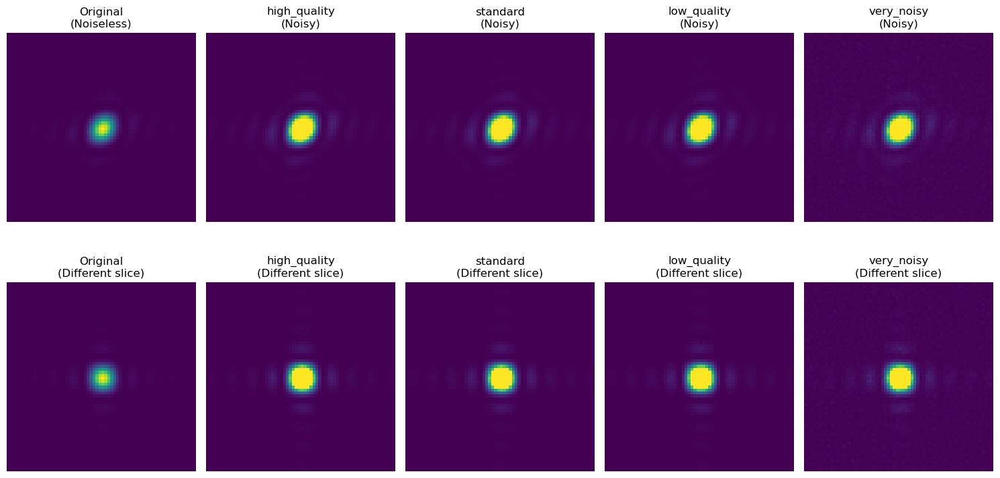

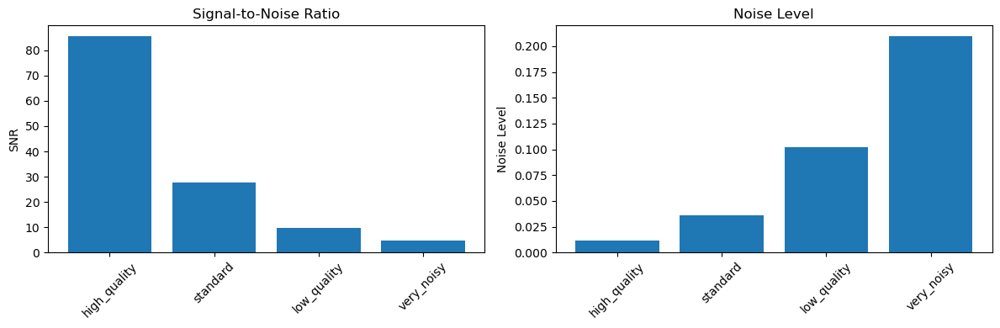


📈 NOISE STATISTICS SUMMARY
----------------------------------------
high_quality    | SNR:  85.55 | Noise: 0.012
standard        | SNR:  27.74 | Noise: 0.036
low_quality     | SNR:   9.78 | Noise: 0.102
very_noisy      | SNR:   4.77 | Noise: 0.210


In [80]:
# Poisson Noise Implementation for Realistic Diffraction Intensity Data
# Simulates realistic experimental conditions with photon shot noise

import numpy as np
import torch
import matplotlib.pyplot as plt
import h5py
from torch.utils.data import Dataset, DataLoader
import copy

class PoissonNoiseDiffractionProcessor:
    """
    Adds realistic Poisson noise to diffraction intensity data
    Simulates photon shot noise in X-ray/electron diffraction experiments
    """
    
    def __init__(self, noise_params=None):
        """
        Args:
            noise_params: Dictionary with noise parameters
                - 'photon_budget': Total photon count (higher = less noise)
                - 'background_level': Background noise level
                - 'detector_gain': Detector gain factor
                - 'dark_current': Dark current noise
        """
        self.noise_params = noise_params or {
            'photon_budget': 1e6,      # 1 million photons (realistic)
            'background_level': 10.0,   # Background counts
            'detector_gain': 1.0,       # Detector gain
            'dark_current': 5.0         # Dark current noise
        }
        
    def normalize_intensity(self, intensity_data):
        """Normalize intensity data to positive values suitable for Poisson noise"""
        # Ensure all values are positive (required for Poisson)
        intensity_normalized = intensity_data - intensity_data.min()
        
        # Scale to reasonable photon count range
        intensity_normalized = intensity_normalized / intensity_normalized.max()
        
        return intensity_normalized
    
    def add_poisson_noise(self, intensity_data, photon_budget=None, add_background=True):
        """
        Add Poisson noise to intensity data
        
        Args:
            intensity_data: Input intensity array (N, 64, 64, 64)
            photon_budget: Total photon count (higher = less noise)
            add_background: Whether to add background noise
        
        Returns:
            noisy_intensity: Intensity data with Poisson noise
            noise_stats: Dictionary with noise statistics
        """
        if photon_budget is None:
            photon_budget = self.noise_params['photon_budget']
        
        print(f"🔬 Adding Poisson noise with photon budget: {photon_budget:.0e}")
        
        # Normalize intensity to [0,1] range
        intensity_norm = self.normalize_intensity(intensity_data)
        
        # Scale by photon budget
        intensity_scaled = intensity_norm * photon_budget
        
        # Add background if requested
        if add_background:
            background = self.noise_params['background_level']
            dark_current = self.noise_params['dark_current']
            intensity_scaled += background + np.random.exponential(dark_current, intensity_scaled.shape)
        
        # Apply Poisson noise (simulates photon shot noise)
        print("   Applying Poisson statistics...")
        noisy_intensity = np.random.poisson(intensity_scaled).astype(np.float32)
        
        # Apply detector gain
        noisy_intensity *= self.noise_params['detector_gain']
        
        # Calculate noise statistics
        snr = np.mean(intensity_scaled) / np.std(noisy_intensity - intensity_scaled)
        noise_level = np.std(noisy_intensity - intensity_scaled) / np.mean(intensity_scaled)
        
        noise_stats = {
            'photon_budget': photon_budget,
            'snr': snr,
            'noise_level': noise_level,
            'mean_counts': np.mean(noisy_intensity),
            'max_counts': np.max(noisy_intensity),
            'background_level': self.noise_params['background_level'] if add_background else 0
        }
        
        print(f"   ✅ Noise added - SNR: {snr:.2f}, Noise level: {noise_level:.3f}")
        
        return noisy_intensity, noise_stats
    
    def add_realistic_detector_effects(self, intensity_data):
        """Add realistic detector effects beyond just Poisson noise"""
        
        print("🔍 Adding realistic detector effects...")
        
        # 1. Pixel response non-uniformity
        height, width, depth = intensity_data.shape[-3:]
        pixel_efficiency = np.random.normal(1.0, 0.02, (height, width, depth))  # 2% variation
        intensity_data = intensity_data * pixel_efficiency
        
        # 2. Dead pixels (random 0.1% of pixels)
        dead_pixel_mask = np.random.random((height, width, depth)) < 0.001
        intensity_data[..., dead_pixel_mask] = 0
        
        # 3. Detector saturation
        saturation_level = np.percentile(intensity_data, 99.9)  # Top 0.1% saturate
        intensity_data = np.clip(intensity_data, 0, saturation_level)
        
        print("   ✅ Detector effects applied")
        
        return intensity_data
    
    def simulate_different_noise_levels(self, intensity_data, noise_levels=None):
        """Simulate different experimental conditions with varying noise levels"""
        
        if noise_levels is None:
            noise_levels = {
                'high_quality': 1e7,      # High photon budget (synchrotron)
                'standard': 1e6,          # Standard lab setup
                'low_quality': 1e5,       # Poor conditions/fast acquisition
                'very_noisy': 1e4         # Very challenging conditions
            }
        
        print("🔬 SIMULATING DIFFERENT NOISE LEVELS")
        print("=" * 50)
        
        noisy_datasets = {}
        noise_statistics = {}
        
        # Take a subset for demonstration
        sample_data = intensity_data[:5] if len(intensity_data) > 5 else intensity_data
        
        for condition, budget in noise_levels.items():
            print(f"\n📊 Condition: {condition} (budget: {budget:.0e})")
            
            noisy_data, stats = self.add_poisson_noise(
                sample_data, 
                photon_budget=budget,
                add_background=True
            )
            
            # Add detector effects
            noisy_data = self.add_realistic_detector_effects(noisy_data)
            
            noisy_datasets[condition] = noisy_data
            noise_statistics[condition] = stats
        
        return noisy_datasets, noise_statistics
    
    def visualize_noise_effects(self, original_data, noisy_datasets, noise_statistics, sample_idx=0, slice_idx=32):
        """Visualize the effect of different noise levels"""
        
        print("📈 Creating noise visualization...")
        
        fig, axes = plt.subplots(2, len(noisy_datasets) + 1, figsize=(15, 8))
        
        # Original data
        axes[0, 0].imshow(original_data[sample_idx, slice_idx, :, :], cmap='viridis')
        axes[0, 0].set_title('Original\n(Noiseless)')
        axes[0, 0].axis('off')
        
        axes[1, 0].imshow(original_data[sample_idx, :, slice_idx, :], cmap='viridis')
        axes[1, 0].set_title('Original\n(Different slice)')
        axes[1, 0].axis('off')
        
        # Noisy data
        for i, (condition, noisy_data) in enumerate(noisy_datasets.items(), 1):
            axes[0, i].imshow(noisy_data[sample_idx, slice_idx, :, :], cmap='viridis')
            axes[0, i].set_title(f'{condition}\n(Noisy)')
            axes[0, i].axis('off')
            
            axes[1, i].imshow(noisy_data[sample_idx, :, slice_idx, :], cmap='viridis')
            axes[1, i].set_title(f'{condition}\n(Different slice)')
            axes[1, i].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Plot noise statistics
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
        
        conditions = list(noisy_datasets.keys())
        snr_values = [noise_statistics[cond]['snr'] for cond in conditions]
        noise_levels = [noise_statistics[cond]['noise_level'] for cond in conditions]
        
        ax1.bar(conditions, snr_values)
        ax1.set_title('Signal-to-Noise Ratio')
        ax1.set_ylabel('SNR')
        ax1.tick_params(axis='x', rotation=45)
        
        ax2.bar(conditions, noise_levels)
        ax2.set_title('Noise Level')
        ax2.set_ylabel('Noise Level')
        ax2.tick_params(axis='x', rotation=45)
        
        plt.tight_layout()
        plt.show()

# Enhanced Dataset class that supports noisy data
class NoisyCrystalDataset(Dataset):
    """Dataset class that can handle both clean and noisy diffraction data"""
    
    def __init__(self, diffraction_data, amplitude_data, noise_processor=None, 
                 noise_level='standard', per_sample_norm=True):
        """
        Args:
            diffraction_data: Clean diffraction intensity data
            amplitude_data: Target amplitude data
            noise_processor: PoissonNoiseDiffractionProcessor instance
            noise_level: Noise level to apply ('high_quality', 'standard', 'low_quality', 'very_noisy')
            per_sample_norm: Whether to normalize per sample
        """
        self.clean_diffraction = torch.FloatTensor(diffraction_data)
        self.amplitude_data = torch.FloatTensor(amplitude_data)
        self.per_sample_norm = per_sample_norm
        
        # Apply noise if processor provided
        if noise_processor is not None:
            print(f"🔬 Applying {noise_level} noise to dataset...")
            noise_levels = {
                'high_quality': 1e7,
                'standard': 1e6,
                'low_quality': 1e5,
                'very_noisy': 1e4
            }
            
            noisy_data, _ = noise_processor.add_poisson_noise(
                diffraction_data, 
                photon_budget=noise_levels.get(noise_level, 1e6),
                add_background=True
            )
            
            # Add detector effects
            noisy_data = noise_processor.add_realistic_detector_effects(noisy_data)
            
            self.diffraction_data = torch.FloatTensor(noisy_data)
            print(f"   ✅ Noisy dataset created with {noise_level} noise")
        else:
            self.diffraction_data = self.clean_diffraction
            print("   📊 Using clean dataset (no noise)")
    
    def __len__(self):
        return len(self.diffraction_data)
    
    def __getitem__(self, idx):
        diffraction = self.diffraction_data[idx]
        amplitude = self.amplitude_data[idx]
        
        if self.per_sample_norm:
            # Normalize each sample individually
            diff_mean, diff_std = diffraction.mean(), diffraction.std() + 1e-8
            amp_mean, amp_std = amplitude.mean(), amplitude.std() + 1e-8
            
            diffraction = (diffraction - diff_mean) / diff_std
            amplitude = (amplitude - amp_mean) / amp_std
            
            return diffraction.unsqueeze(0), amplitude.unsqueeze(0), amp_mean, amp_std
        
        return diffraction.unsqueeze(0), amplitude.unsqueeze(0)

# Integration function for your Crystal3DCNN training
def train_with_realistic_noise(crystal_model_class, intensity_data, amplitude_data, 
                             noise_level='standard', num_epochs=10):
    """
    Train Crystal3DCNN with realistic Poisson noise
    
    Args:
        crystal_model_class: Your Crystal3DCNN class
        intensity_data: Clean intensity data
        amplitude_data: Target amplitude data  
        noise_level: Noise level to apply
        num_epochs: Training epochs
    
    Returns:
        trained_model: Model trained on noisy data
        noise_processor: Processor used for noise generation
    """
    
    print("🎯 TRAINING CRYSTAL3DCNN WITH REALISTIC NOISE")
    print("=" * 60)
    
    # Initialize noise processor
    noise_processor = PoissonNoiseDiffractionProcessor()
    
    # Create noisy dataset
    noisy_dataset = NoisyCrystalDataset(
        intensity_data, 
        amplitude_data,
        noise_processor=noise_processor,
        noise_level=noise_level,
        per_sample_norm=True
    )
    
    # Create data loaders
    train_size = int(0.8 * len(noisy_dataset))
    val_size = len(noisy_dataset) - train_size
    train_dataset, val_dataset = torch.utils.data.random_split(
        noisy_dataset, [train_size, val_size]
    )
    
    train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)
    
    # Initialize and train model
    model = crystal_model_class()
    device = torch.device('cpu')
    model.to(device)
    
    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)
    
    print(f"🚀 Training with {noise_level} noise level...")
    
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0
        
        for batch_idx, data in enumerate(train_loader):
            if len(data) == 4:
                inputs, targets, _, _ = data
            else:
                inputs, targets = data
                
            inputs, targets = inputs.to(device), targets.to(device)
            
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            
            epoch_loss += loss.item()
            
            if batch_idx % 50 == 0:
                print(f'Epoch {epoch+1}/{num_epochs}, Batch {batch_idx+1}, Loss: {loss.item():.6f}')
        
        avg_loss = epoch_loss / len(train_loader)
        print(f'Epoch {epoch+1}/{num_epochs}: Average Loss: {avg_loss:.6f}')
        print('-' * 40)
    
    print("✅ Training with realistic noise completed!")
    
    return model, noise_processor

# Usage example for your data
def apply_noise_to_your_data():
    """Example of how to apply noise to your loaded data"""
    
    print("🔬 APPLYING REALISTIC NOISE TO YOUR CRYSTAL DATA")
    print("=" * 60)
    
    # Load your data (same as in your notebook)
    file_path = r'C:\Users\D\Documents\ni_range_dataset.h5'
    
    with h5py.File(file_path, 'r') as f:
        intensity = np.array(f['intensity'])
        amplitude = np.array(f['amplitude'])
    
    print(f"📊 Loaded data shapes: {intensity.shape}, {amplitude.shape}")
    
    # Initialize noise processor
    noise_processor = PoissonNoiseDiffractionProcessor()
    
    # Simulate different noise conditions
    noisy_datasets, noise_stats = noise_processor.simulate_different_noise_levels(intensity)
    
    # Visualize results (now passing noise_stats)
    noise_processor.visualize_noise_effects(intensity, noisy_datasets, noise_stats)
    
    # Print noise statistics
    print("\n📈 NOISE STATISTICS SUMMARY")
    print("-" * 40)
    for condition, stats in noise_stats.items():
        print(f"{condition:15} | SNR: {stats['snr']:6.2f} | Noise: {stats['noise_level']:.3f}")
    
    return noisy_datasets, noise_stats, noise_processor

# Example usage:
if __name__ == "__main__":
    # This would apply noise to your actual data
    noisy_data, stats, processor = apply_noise_to_your_data()

🔬 APPLYING REALISTIC NOISE TO YOUR CRYSTAL DATA
📊 Loaded data shapes: (500, 64, 64, 64), (500, 64, 64, 64)
🔬 SIMULATING DIFFERENT NOISE LEVELS

📊 Condition: high_quality (budget: 1e+07)
🔬 Adding Poisson noise with photon budget: 1e+07
   Applying Poisson statistics...
   ✅ Noise added - SNR: 84.62, Noise level: 0.012
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: standard (budget: 1e+06)
🔬 Adding Poisson noise with photon budget: 1e+06
   Applying Poisson statistics...
   ✅ Noise added - SNR: 27.17, Noise level: 0.037
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: low_quality (budget: 1e+05)
🔬 Adding Poisson noise with photon budget: 1e+05
   Applying Poisson statistics...
   ✅ Noise added - SNR: 9.55, Noise level: 0.105
🔍 Adding realistic detector effects...
   ✅ Detector effects applied

📊 Condition: very_noisy (budget: 1e+04)
🔬 Adding Poisson noise with photon budget: 1e+04
   Applying Poisson statistics...
   ✅

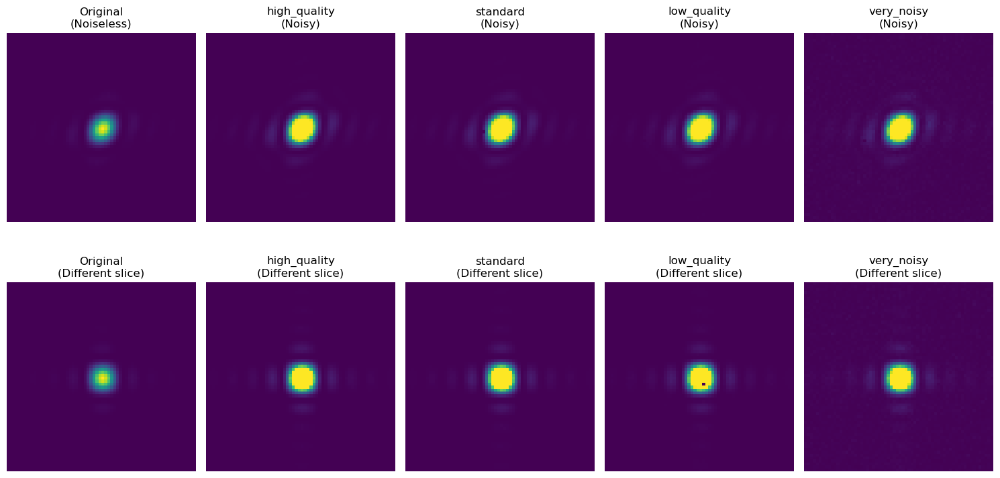

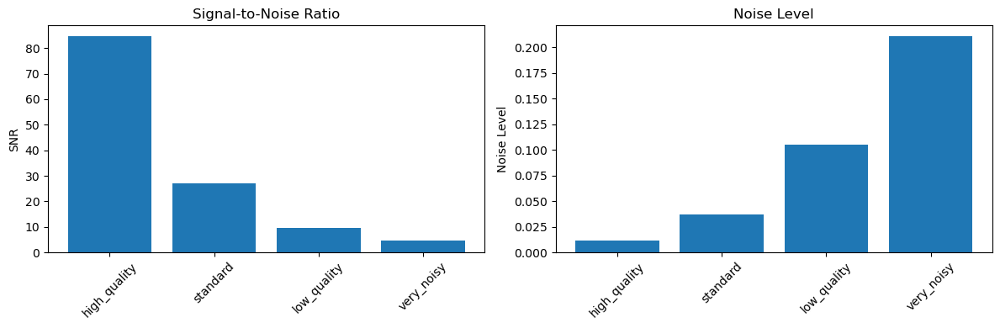


📈 NOISE STATISTICS SUMMARY
----------------------------------------
high_quality    | SNR:  84.62 | Noise: 0.012
standard        | SNR:  27.17 | Noise: 0.037
low_quality     | SNR:   9.55 | Noise: 0.105
very_noisy      | SNR:   4.75 | Noise: 0.211


In [81]:
# Apply to your existing data
noisy_datasets, noise_stats, processor = apply_noise_to_your_data()



In [82]:
# Train a new model with realistic noise
noisy_model, processor = train_with_realistic_noise(
    Crystal3DCNN,  # Your model class
    intensity,     # Your intensity data  
    amplitude,     # Your amplitude data
    noise_level='standard',
    num_epochs=10
)



🎯 TRAINING CRYSTAL3DCNN WITH REALISTIC NOISE
🔬 Applying standard noise to dataset...
🔬 Adding Poisson noise with photon budget: 1e+06
   Applying Poisson statistics...
   ✅ Noise added - SNR: 17.89, Noise level: 0.056
🔍 Adding realistic detector effects...
   ✅ Detector effects applied
   ✅ Noisy dataset created with standard noise
🚀 Training with standard noise level...
Epoch 1/10, Batch 1, Loss: 1.782170
Epoch 1/10, Batch 51, Loss: 0.227799
Epoch 1/10, Batch 101, Loss: 0.329260
Epoch 1/10, Batch 151, Loss: 0.218104
Epoch 1/10, Batch 201, Loss: 0.194574
Epoch 1/10, Batch 251, Loss: 0.208206
Epoch 1/10, Batch 301, Loss: 0.181026
Epoch 1/10, Batch 351, Loss: 0.196457
Epoch 1/10: Average Loss: 0.210194
----------------------------------------
Epoch 2/10, Batch 1, Loss: 0.176139
Epoch 2/10, Batch 51, Loss: 0.166264
Epoch 2/10, Batch 101, Loss: 0.164662
Epoch 2/10, Batch 151, Loss: 0.134969
Epoch 2/10, Batch 201, Loss: 0.157309
Epoch 2/10, Batch 251, Loss: 0.143356
Epoch 2/10, Batch 301, L

In [83]:
# Then apply compression techniques to the noise-trained model
compression_results = compress_crystal_model(noisy_model)

🔧 CRYSTAL3DCNN COMPRESSION TOOLKIT

🔍 COMPREHENSIVE MODEL COMPRESSION ANALYSIS

📊 Applying all compression techniques...
🔥 Applying magnitude pruning (sparsity: 30.0%)...
Found 19 Conv3D layers to prune
✅ Magnitude pruning completed!
   Target sparsity: 30.0%
   Actual sparsity: 30.0%
   Zero parameters: 7,058,803/23,538,177
🏗️ Applying structured pruning (ratio: 20.0%)...
✅ Structured pruning completed!
   Parameter reduction: 0.0%
   Parameters: 23,538,177 → 23,538,177
📈 Applying gradual magnitude pruning...
   Final sparsity: 40.0% over 5 steps
   Step 1/5: 8.0% sparsity
   Step 2/5: 16.0% sparsity
   Step 3/5: 24.0% sparsity
   Step 4/5: 32.0% sparsity
   Step 5/5: 40.0% sparsity
✅ Gradual pruning completed!
   Final sparsity achieved: 32.0%
🎯 Applying mixed precision quantization...
✅ Mixed precision quantization completed!
🔢 Applying 8-bit quantization...
✅ Dynamic 8-bit quantization successful!
🎓 Creating lightweight student model...
✅ Lightweight student created!
   Teacher par

C:\Users\D\AppData\Local\Temp\ipykernel_25992\1726756169.py:199: DeprecationWarning:

torch.ao.quantization is deprecated and will be removed in 2.10. 
For migrations of users: 
1. Eager mode quantization (torch.ao.quantization.quantize, torch.ao.quantization.quantize_dynamic), please migrate to use torchao eager mode quantize_ API instead 
2. FX graph mode quantization (torch.ao.quantization.quantize_fx.prepare_fx,torch.ao.quantization.quantize_fx.convert_fx, please migrate to use torchao pt2e quantization API instead (prepare_pt2e, convert_pt2e) 
3. pt2e quantization has been migrated to torchao (https://github.com/pytorch/ao/tree/main/torchao/quantization/pt2e) 
see https://github.com/pytorch/ao/issues/2259 for more details



Original model size: 89.851 MB
magnitude_pruned     | 89.851 MB ( +0.0%) | 62.45ms
structured_pruned    | 89.851 MB ( +0.0%) | 64.72ms
gradual_pruned       | 89.851 MB ( +0.0%) | 66.87ms
❌ mixed_precision benchmark failed: Input type (float) and bias ty...
mixed_precision      | 44.945 MB (+50.0%) | Benchmark failed
8bit_dynamic         | 89.851 MB ( +0.0%) | 64.12ms
lightweight_student  | 5.608 MB (+93.8%) | 50.73ms
❌ combined_optimized benchmark failed: Input type (float) and bias ty...
combined_optimized   | 44.945 MB (+50.0%) | Benchmark failed

🏆 BEST COMPRESSION TECHNIQUE
------------------------------
Technique: lightweight_student
Size reduction: 93.8%
Final size: 5.608 MB
Inference speed: 50.73ms
✅ Saved as: best_compressed_lightweight_student.pth

✅ Compression completed successfully!
📦 Original size: 89.851 MB
📦 Optimized size: 5.608 MB
📊 Reduction: 93.8%
